In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
!pip install normflows nflows einops ipdb torchsde torchdiffeq

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.3/65.3 kB 9.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 6.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 11.5 MB/s eta 0:00:00
  Created wheel for normflows: filename=normflows-1.7.3-py2.py3-none-any.whl size=87246 sha256=cd8a6468eabc2b3e6bbf88581f610cb0e346f068d228d53370e4ac0618123569
  Stored in directory: /home/ray/.cache/pip/wheels/34/b2/f3/e97b5a749e1b93adfdca027b9050d0ee4d4790c5a5dec45a6d
  Created wheel for nflows: filename=nflows-0.14-py3-none-any.whl size=53653 sha256=6d9f3d1c7a26a660170e43f9f665ce37b2eff789c938ba6d3e6ecb1cb4a39143
  Stored in directory: /home/ray/.cache/pip/wheels/3b/88/52/cbd4ed0597b48916de3de19b28d7297c72595f56085068c772
Successfully built normflows nflows

[notice] A new release of pip

In [3]:
!pip install torch==2.0.1+cu118 --index-url https://download.pytorch.org/whl/cu118

Looking in indexes: https://download.pytorch.org/whl/cu118
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 GB 587.4 kB/s eta 0:00:000:01m0:01m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 MB 30.8 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: torch
    Found existing installation: torch 2.1.0+rocm5.6
    Uninstalling torch-2.1.0+rocm5.6:
      Successfully uninstalled torch-2.1.0+rocm5.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pytorch-lightning 1.6.5 requires protobuf<=3.20.1, but you have protobuf 3.20.3 which is incompatible.
pytorch-lightning 1.6.5 requires PyYAML>=5.4, but you have pyyaml 5.3.1 which is incompatible.
torchtext 0.14.0 requires torch==1.13.0, but you have torch 2.0.1+cu118 which is incompatible.
torchvision 0.14.0+cu116 requires torch==1.13.0, but you have torch 2.0.1+cu118 which is incompatible.

[notice] A new r

In [4]:
import normflows as nf
import matplotlib.pyplot as plt
import torch
import numpy as np
from torch.optim import Adam
from torch.utils.data import TensorDataset, DataLoader
from fab import FABModel, HamiltonianMonteCarlo, Metropolis
from fab.utils.logging import ListLogger
from fab.utils.plotting import plot_history, plot_contours, plot_marginal_pair
from fab.target_distributions.gmm import GMM
from fab.utils.prioritised_replay_buffer import SimpleBuffer
from torch.autograd import grad
from fab.utils.plotting import plot_contours, plot_marginal_pair
from experiments.make_flow import make_wrapped_normflow_realnvp
import models.ddpm
import models.mlp
import pdb
from tqdm import tqdm
from models.ddpm import GaussianDiffusion, TMLP
from models.mlp import MyMLP, SpectralNormMLP, MyMLPNoSpaceEmbedding, MyMLPNoEmbedding

import torch
import torchsde

from functorch import vmap

from torchdiffeq import odeint

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


### Target Distribution

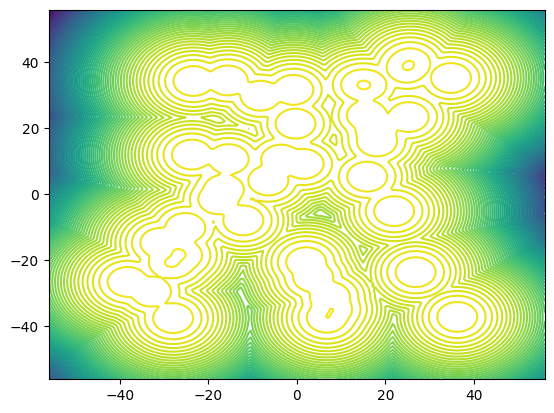

In [72]:
dim = 2
n_mixes = 40
loc_scaling = 40.0  # scale of the problem (changes how far apart the modes of each Guassian component will be)
log_var_scaling = 1.0 # variance of each Gaussian
seed = 0


if device == "cpu":
    use_gpu = False
else:
    use_gpu = True
torch.manual_seed(0)  # seed of 0 for GMM problem
target = GMM(dim=dim, n_mixes=n_mixes,
              loc_scaling=loc_scaling, log_var_scaling=log_var_scaling,
              use_gpu=use_gpu, true_expectation_estimation_n_samples=int(1e5))
# plot target
target.to("cpu")
fig, ax = plt.subplots()
plotting_bounds = (-loc_scaling * 1.4, loc_scaling * 1.4)
plot_contours(target.log_prob, bounds=plotting_bounds, n_contour_levels=80, ax=ax, grid_width_n_points=200)
target.to(device)

### Helper Functions

In [8]:
def plot_dataset(samples, gen_samples=None):
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))
    target.to("cpu")
    plot_contours(target.log_prob, bounds=plotting_bounds, ax=axs[0], n_contour_levels=50, grid_width_n_points=200)

   
    # plot dataset samples
    plot_marginal_pair(samples, ax=axs[0], bounds=plotting_bounds)
    axs[0].set_title("Buffer")

    if gen_samples is not None:
        plot_contours(target.log_prob, bounds=plotting_bounds, ax=axs[1], n_contour_levels=50, grid_width_n_points=200)
        # plot generated samples
        plot_marginal_pair(gen_samples, ax=axs[1], bounds=plotting_bounds)
        axs[1].set_title("Generated samples")

    else:
        #delete subplot
        fig.delaxes(axs[1])
        
    target.to(device)
    plt.show()
    return [fig]

In [9]:
def normalize(x):
    '''
        normalizes to [-1, 1]
    '''
    mins = -50 #torch.min(x, dim=0)[0]
    maxs = 50 #torch.max(x, dim=0)[0]
    ## [ 0, 1 ]
    x = (x - mins) / (maxs - mins + 1e-5)
    ## [ -1, 1 ]
    x = x * 2 - 1
    
    return x, mins, maxs

def unnormalize(x, mins, maxs):
    '''
        x : [ -1, 1 ]
    '''
    # assert x.max() <= 1 and x.min() >= -1, f'x range: ({x.min():.4f}, {x.max():.4f})'
    #x = x * std + mean
    x = (x + 1) / 2
    return x * (maxs - mins) + mins

## Function Definitions

### Estimated Reward Functions

In [10]:
# calculate the log expectation of the reward
def log_E_R(_x, _t, noise_schedule, num_mc_samples, global_mins=-50, global_maxs=50, var_exploding=True):
    #h_t = beta * _t.repeat_interleave(num_mc_samples).unsqueeze(1)
    
    repeated_x = _x.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    repeated_t = _t.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    
    h_t = noise_schedule.h(repeated_t)
    #h_t  = beta * repeated_t
    h_t = h_t.unsqueeze(1)
    if var_exploding:
        # variance exploding
        samples = repeated_x + torch.randn(repeated_x.shape).to(device) * (h_t ** 0.5)
        log_rewards = target.log_prob(unnormalize(samples, global_mins, global_maxs))
        log_expectation_R = torch.logsumexp(log_rewards, dim=-1) - np.log(num_mc_samples)
    else:
        # variance preserving
        samples = (repeated_x/torch.sqrt(1 - repeated_t.unsqueeze(1)) 
                   + torch.randn(repeated_x.shape).to(device) * (h_t ** 0.5))
        log_rewards = target.log_prob(unnormalize(samples, global_mins, global_maxs))
        log_expectation_R = torch.log(1 / (1 - _t)) + torch.logsumexp(log_rewards, dim=-1) - np.log(num_mc_samples)
    return log_expectation_R

In [11]:
def estimated_Rt(x, t, beta, num_mc_samples=100, var_exploding=True):
    if t.dim() == 0:
        # repeat the same time for all points if we have a scalar time
        t = t * torch.ones(x.shape[0]).to(device)
    return torch.vmap(log_E_R, 
                      randomness='different', in_dims=(0,0,None,None))(x, t, beta, 
                                                                       num_mc_samples, var_exploding=var_exploding)

In [12]:
def estimate_grad_Rt(x, t, noise_schedule, num_mc_samples=200, var_exploding=True, richardson=False):
    if x.ndim == 1:
        x = x.unsqueeze(0)
        t = t.unsqueeze(0)
    
    est_scores_n = torch.vmap(torch.func.grad(log_E_R), 
                            in_dims=(0,0,None,None), randomness='different')(x, t, noise_schedule, num_mc_samples, 
                                                                                  var_exploding=var_exploding)
    return est_scores_n
    norm = torch.linalg.vector_norm(est_scores_n, dim=-1)
    #print(norm.max())
    max_norm = 100
    clip_coeff = torch.clamp(max_norm / (norm+1e-6), max=1)
    clipped_f = est_scores_n * clip_coeff.unsqueeze(-1)
    
    return clipped_f#.clamp(min=-100.0, max=100.0)
    
    if richardson:
        est_scores_n_div2 = torch.vmap(torch.func.grad(log_E_R), 
                                   in_dims=(0,0,None,None), randomness='different')(x, t, beta, num_mc_samples//2, 
                                                                                         var_exploding=var_exploding)
        return (2*est_scores_n - est_scores_n_div2)
    else:
        return est_scores_n

### True Reward Functions

In [13]:
def true_Rt(x, t, noise_schedule, global_mins=-50, global_maxs=50, var_exploding=True):
    h_t = noise_schedule.h(t)
    target.convolve(h_t * (global_maxs **2), t, var_exploding=var_exploding)
    energy = target.log_prob(unnormalize(x, global_mins, global_maxs))
    target.reset()
    return energy

In [14]:
def true_grad_Rt(x, t, noise_schedule, var_exploding=True):
    samples_energy = true_Rt(x, t[0], noise_schedule, var_exploding=var_exploding)
    true_scores = torch.autograd.grad(samples_energy.sum(), x, retain_graph=True)[0].detach()
    return true_scores

## SDE Tests

### Dataset

In [15]:
# hyper-parameters

# Flow
n_flow_layers = 15
layer_nodes_per_dim = 40
lr = 1e-4
max_gradient_norm = 100.0
batch_size = 128
n_iterations = 4000
n_eval = 10
eval_batch_size = batch_size * 10
n_plots = 10 # number of plots shows throughout tranining
use_64_bit = True
alpha = 2.0
num_samples = 10000

flow = make_wrapped_normflow_realnvp(dim, n_flow_layers=n_flow_layers, 
                                 layer_nodes_per_dim=layer_nodes_per_dim,
                                act_norm = False)

/home/ray/anaconda3/lib/python3.9/site-packages/torch/_tensor.py:677: UserWarning: torch.lu is deprecated in favor of torch.linalg.lu_factor / torch.linalg.lu_factor_ex and will be removed in a future PyTorch release.
LU, pivots = torch.lu(A, compute_pivots)
should be replaced with
LU, pivots = torch.linalg.lu_factor(A, compute_pivots)
and
LU, pivots, info = torch.lu(A, compute_pivots, get_infos=True)
should be replaced with
LU, pivots, info = torch.linalg.lu_factor_ex(A, compute_pivots) (Triggered internally at ../aten/src/ATen/native/BatchLinearAlgebra.cpp:1991.)
  LU, pivots, infos = torch._lu_with_info(


In [16]:
# normalize the dataset
init_num_samples = 2048
unnorm_true_samples = target.sample(torch.tensor(init_num_samples).unsqueeze(0)).to(device).detach()
unnorm_init_samples = flow.sample((init_num_samples,)).to(device).detach()
init_energy = target.log_prob(unnorm_init_samples).detach()
init_samples, global_mins_init, global_maxs_init = normalize(unnorm_init_samples)

global_mins_init = -50
global_maxs_init = 50

init_dataset = TensorDataset(init_samples, init_energy)
init_loader = DataLoader(init_dataset, batch_size = 512, shuffle=True) 

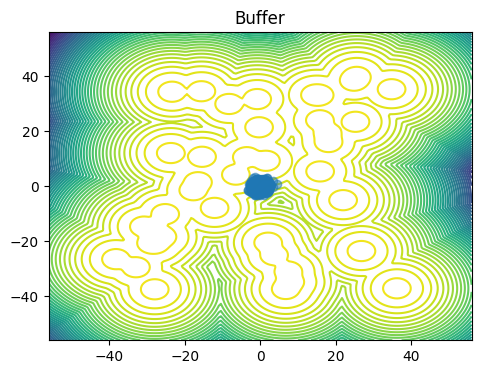

In [17]:
plot_dataset(unnorm_init_samples) # visualise the initial samples
plt.show()

### VE SDE

In [1]:
class VEReverseSDE(torch.nn.Module):
    noise_type = 'diagonal'
    sde_type = 'ito'
    
    def __init__(self, score, noise_schedule):
        super().__init__()
        self.score = score
        self.noise_schedule = noise_schedule
    
    def f(self, t, x):
        #import pdb; pdb.set_trace()
        with torch.enable_grad():
            if t.dim() == 0:
                # repeat the same time for all points if we have a scalar time
                t = t * torch.ones(x.shape[0]).to(device)

            x.requires_grad = True
            score = self.score(x, 1-t, self.noise_schedule)
        
        #import pdb; pdb.set_trace()
        return (self.g(t, x)**2) * score 
    
    def g(self, t, x):
        g = self.noise_schedule.g(1 - t)
        if g.ndim > 0:
            g = g.unsqueeze(1)
        else:
            g = torch.full_like(x, g)
            
        return g

NameError: name 'torch' is not defined

In [19]:
from abc import ABC, abstractmethod

class NoiseSchedule(ABC):
    @abstractmethod
    def g(t):
        # Returns g(t)
        pass
    
    @abstractmethod
    def h(t):
        # Returns \int_0^t g(t)^2 dt
        pass

    
class LinearNoiseSchedule(NoiseSchedule):
    def __init__(self, beta, norm_factor=1.0):
        self.beta = beta / norm_factor
        
    def g(self, t):
        return self.beta.sqrt()
    
    def h(self, t):
        return self.beta * t

class GeometricNoiseSchedule(NoiseSchedule):
    def __init__(self, sigma_min, sigma_max, norm_factor=1.0):
        self.sigma_min = sigma_min / norm_factor
        self.sigma_max = sigma_max / norm_factor
        self.sigma_diff = self.sigma_max / self.sigma_min
        
    def g(self, t):
        # Let sigma_d = sigma_max / sigma_min
        # Then g(t) = sigma_min * sigma_d^t * sqrt{2 * log(sigma_d)}
        # See Eq 192 in https://arxiv.org/pdf/2206.00364.pdf
        return self.sigma_min * (self.sigma_diff ** t) * ((2 * np.log(self.sigma_diff)) ** 0.5)
        
    def h(self, t):
        # Let sigma_d = sigma_max / sigma_min
        # Then h(t) = \int_0^t g(z)^2 dz = sigma_min * sqrt{sigma_d^{2t} - 1}
        # see Eq 199 in https://arxiv.org/pdf/2206.00364.pdf
        return (self.sigma_min * (((self.sigma_diff ** (2 * t)) - 1) ** 0.5)) ** 2

In [20]:
def generate_samples(ve_reverse_sde, x_init):
    t = torch.linspace(0.001, 1.0, 500).to(device)
    with torch.no_grad():
        samples = torchsde.sdeint(ve_reverse_sde, x_init, t)
    return samples

In [21]:
def euler_maruyama_step(sde, x, t, dt):
    # Calculate drift and diffusion terms
    drift = sde.f(t, x) * dt
    diffusion = sde.g(t, x) * np.sqrt(dt) * torch.randn_like(x).to(device)

    #import pdb; pdb.set_trace()
    # Update the state
    x_next = x + drift + diffusion
    return x_next, drift

def integrate_sde(sde, x0, t_span, dt):
    times = torch.arange(t_span[0], t_span[1], dt).to(device)
    x = x0
    x0.requires_grad = True
    pred_v = []
    true_v = []
    samples = []
    with torch.no_grad():
        for t in times:
            x, f = euler_maruyama_step(sde, x, t, dt)
            samples.append(x)
            pred_v.append(f)
            # true_v.append(true_grad_Rt(x, 1-t, beta))
    return torch.stack(samples), torch.stack(pred_v) # , torch.stack(true_v)

In [404]:
num_samples = 512
beta = noise_schedule.h(1.0) / (50 ** 2)#0.2

var = beta * (50 ** 2)
with torch.no_grad():
    target.convolve(torch.tensor(beta * (50 ** 2), device=torch.device('cpu')), 1)
    x1_samples = target.sample((num_samples,))
    target.reset()
    #x1_samples = torch.randn((num_samples, 2), device='cuda') * (var ** 0.5)
    x1_samples_normalized = normalize(x1_samples)[0]

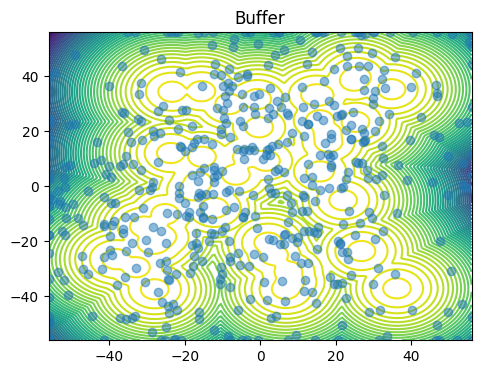

[<Figure size 1200x400 with 1 Axes>]

In [23]:
plot_dataset(x1_samples)

In [420]:
# ve_reverse_sde = VEReverseSDE(true_grad_Rt, beta)
#noise_schedule = LinearNoiseSchedule(torch.tensor(500), 50 ** 2)
noise_schedule = GeometricNoiseSchedule(0.01, 500, 50 ** 2)

In [25]:
ve_reverse_sde = VEReverseSDE(estimate_grad_Rt, noise_schedule)
# samples = generate_samples(ve_reverse_sde, x1_s'amples_normalized)
samples, pred_vectors = integrate_sde(ve_reverse_sde, x1_samples_normalized, [0, 1.0], 0.001) #true_vectors

In [549]:
import scipy.integrate as integrate

t = 0.8
print(integrate.quad(lambda x: noise_schedule.g(x).pow(2), 0.0, t)[0] ** 0.5)
print(noise_schedule.h(t))

0.022973966269791268
tensor(0.0005)


In [550]:
noise_schedule.h(0.5)

tensor(7.9998e-07)

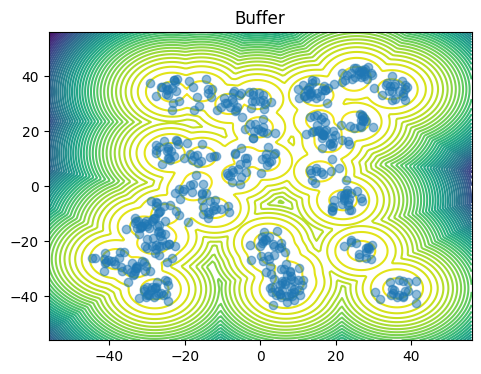

[<Figure size 1200x400 with 1 Axes>]

In [26]:
plot_dataset(unnormalize(samples[-1], global_mins_init, global_maxs_init))

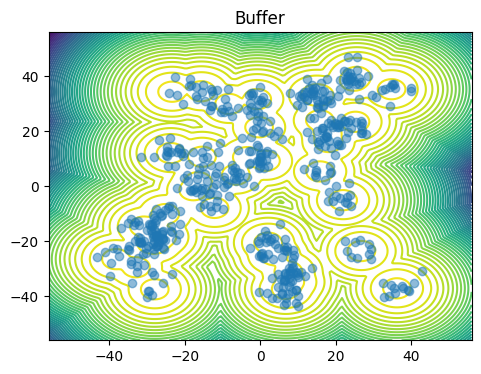

[<Figure size 1200x400 with 1 Axes>]

In [27]:
target.convolve(noise_schedule.h(0.01) * 50 * 50, 1)
v = target.sample((512,))
target.reset()
plot_dataset(v)

In [ ]:
plot_dataset(unnormalize(true_samples[-1], global_mins_init, global_maxs_init))

In [ ]:
plot_dataset(unnormalize(model_samples[-1], global_mins_init, global_maxs_init))

In [ ]:
unnormalized_samples = unnormalize(samples, global_mins_init, global_maxs_init)

plt.plot(torch.arange(0, 1.0, 0.001), unnormalized_samples[:, 105:110, 0].detach().cpu())
plt.xlabel('time')
plt.show()

In [ ]:
unnormalized_samples = unnormalize(model_samples, global_mins_init, global_maxs_init)

plt.plot(torch.arange(0, 1.0, 0.001), unnormalized_samples[:, 105:110, 0].detach().cpu())
plt.xlabel('time')
plt.show()

In [528]:
ve_reverse_sde = VEReverseSDE(true_grad_Rt, noise_schedule)
# samples = generate_samples(ve_reverse_sde, x1_samples_normalized)
true_samples, true_vectors = integrate_sde(ve_reverse_sde, x1_samples_normalized, [0, 0.999], 0.001) #true_vectors

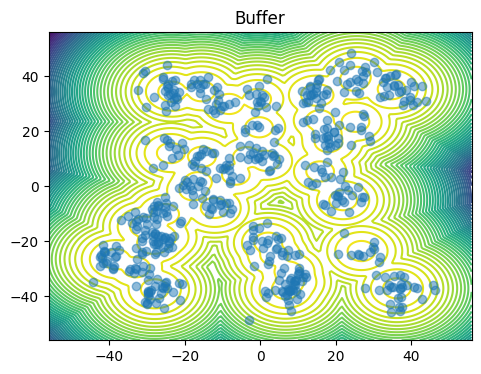

[<Figure size 1200x400 with 1 Axes>]

In [529]:
plot_dataset(unnormalize(true_samples[-1], global_mins_init, global_maxs_init))

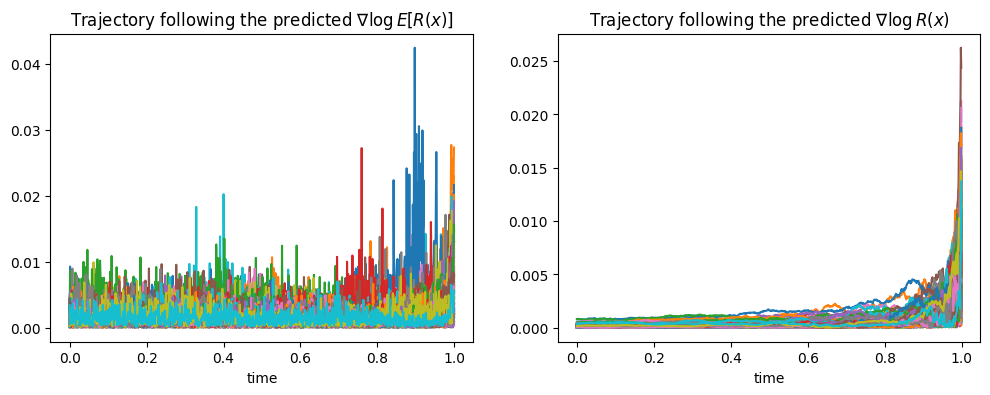

In [26]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))
# predicted 
traj_pred = torch.cumsum(pred_vectors, dim=-1)
axs[0].plot(torch.arange(0, 1, 0.001), torch.linalg.norm(traj_pred[:,:200], dim=-1).cpu())
axs[0].set_xlabel("time")
axs[0].set_title(r"Trajectory following the predicted $\nabla \log E[R(x)]$")


# true
traj_true = torch.cumsum(true_vectors, dim=-1)
axs[1].plot(torch.arange(0, 1, 0.001), torch.linalg.norm(traj_true[:,:200], dim=-1).cpu())
axs[1].set_xlabel("time")
axs[1].set_title(r"Trajectory following the predicted $\nabla \log R(x)$")

plt.show()

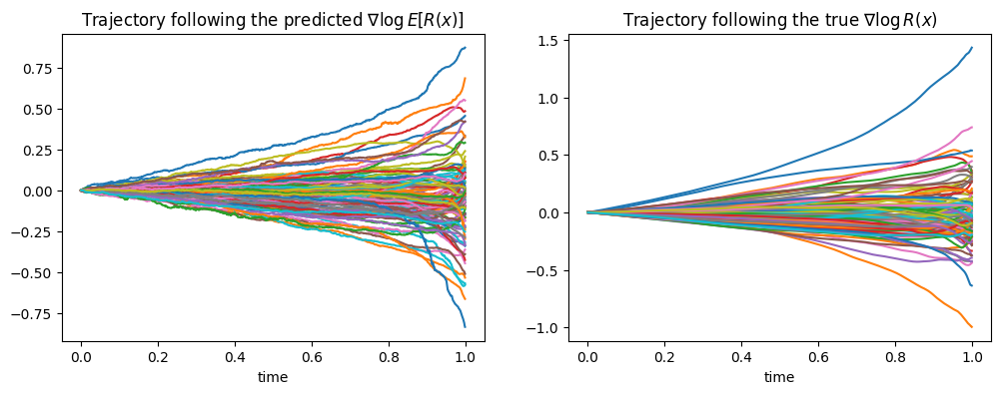

In [27]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

# predicted 
# plt.plot(torch.arange(0, 1, 0.001), torch.cumsum(traj_norm_pred, dim=0).cpu())
axs[0].plot(torch.arange(0, 1, 0.001)[:], torch.cumsum(pred_vectors[:, :100, 0], dim=0).cpu())
axs[0].set_xlabel("time")
axs[0].set_title(r"Trajectory following the predicted $\nabla \log E[R(x)]$")


# true
# plt.plot(torch.arange(0, 1, 0.001), torch.cumsum(traj_norm_true, dim=0).cpu())
axs[1].plot(torch.arange(0, 1, 0.001), torch.cumsum(true_vectors[:, :100, 0], dim=0).cpu())
axs[1].set_xlabel("time")
axs[1].set_title(r"Trajectory following the true $\nabla \log R(x)$")

plt.show()

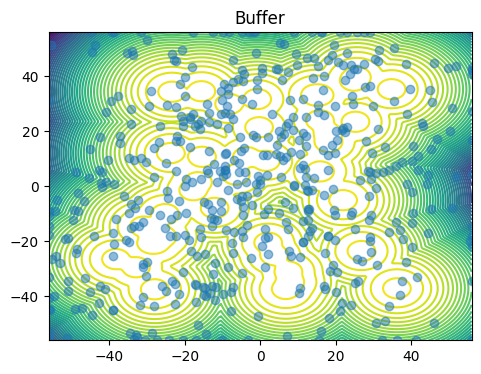

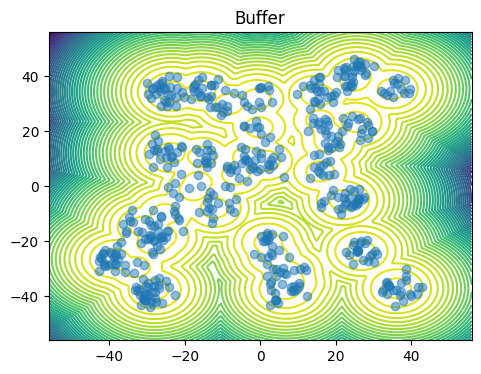

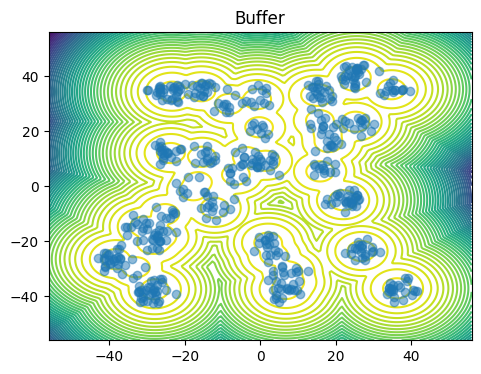

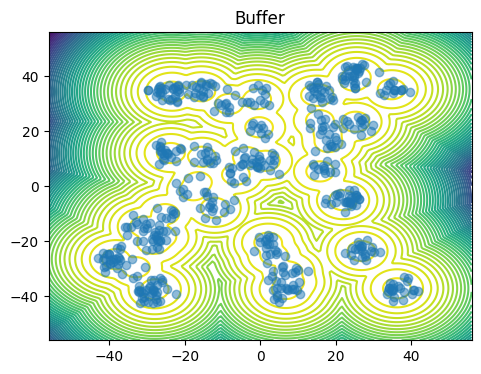

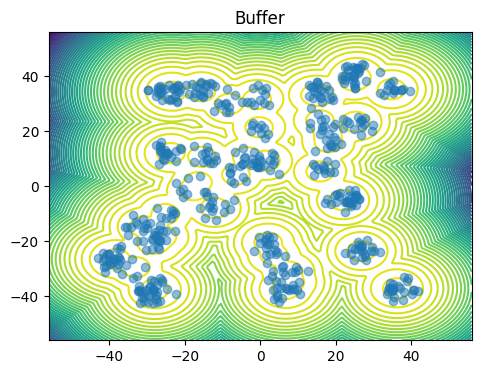

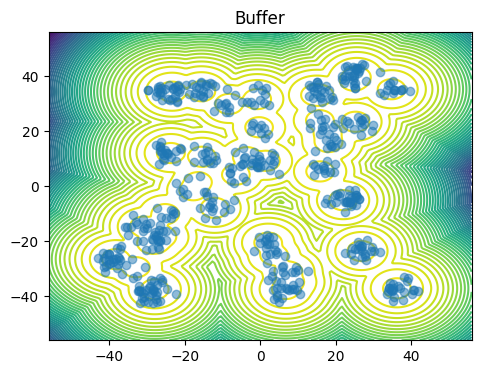

In [553]:
for i in range(0, samples.shape[0], 199):
    plot_dataset(unnormalize(samples[i], global_mins_init, global_maxs_init))

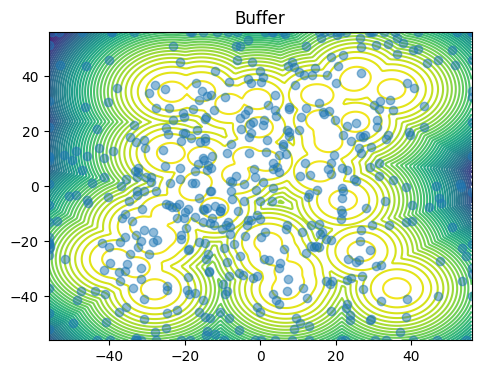

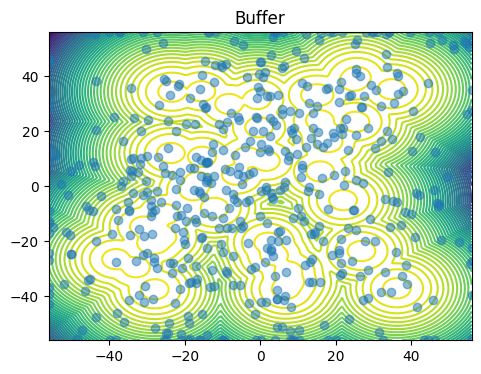

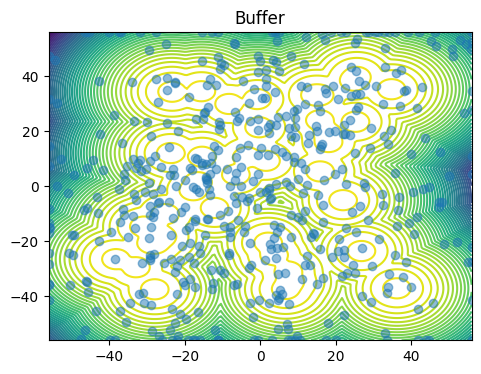

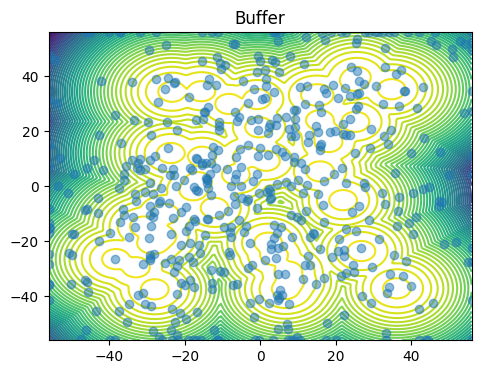

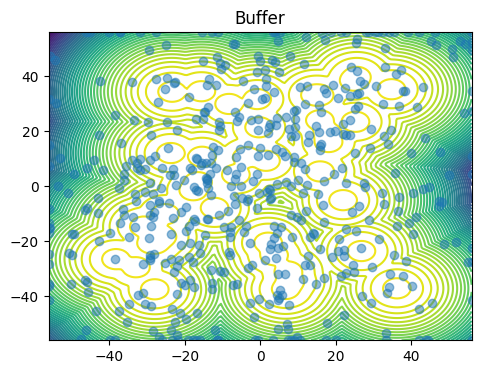

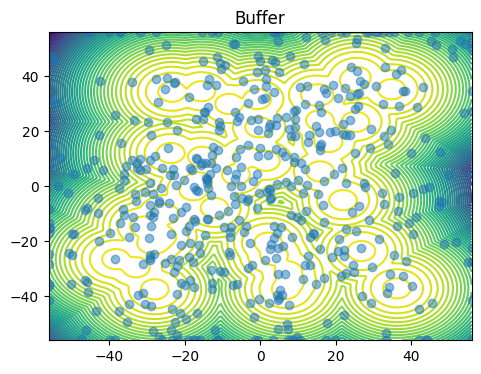

In [440]:
for i in range(0, true_samples.shape[0], 199):
    plot_dataset(unnormalize(true_samples[i], global_mins_init, global_maxs_init))

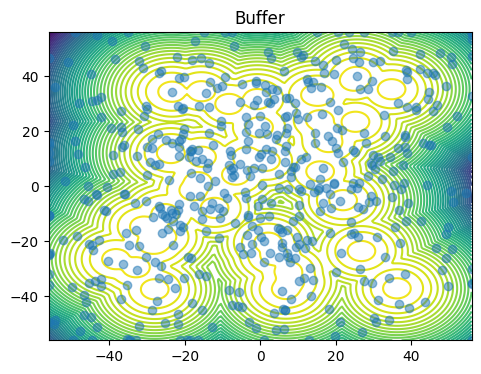

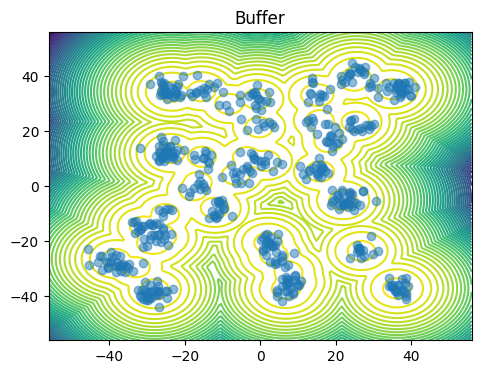

[<Figure size 1200x400 with 1 Axes>]

In [177]:
plot_dataset(unnormalize(true_samples[0], global_mins_init, global_maxs_init))
plot_dataset(unnormalize(true_samples[30], global_mins_init, global_maxs_init))

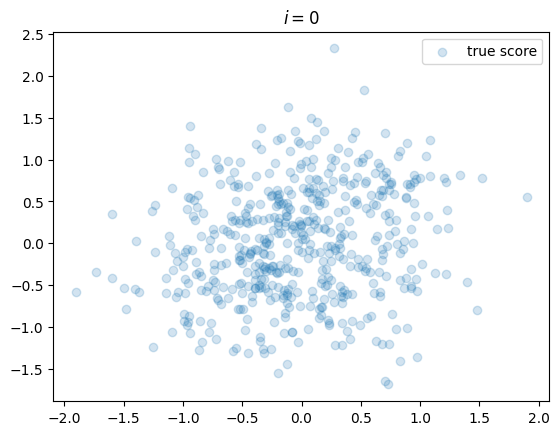

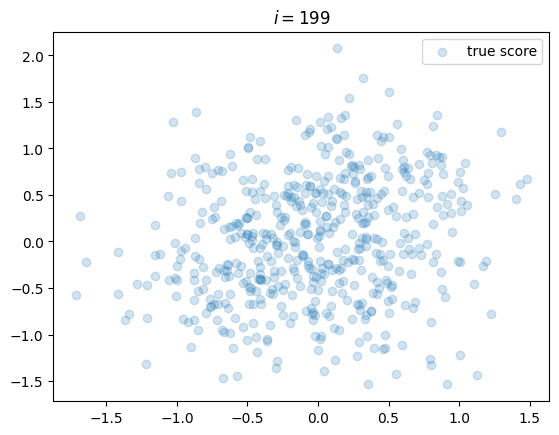

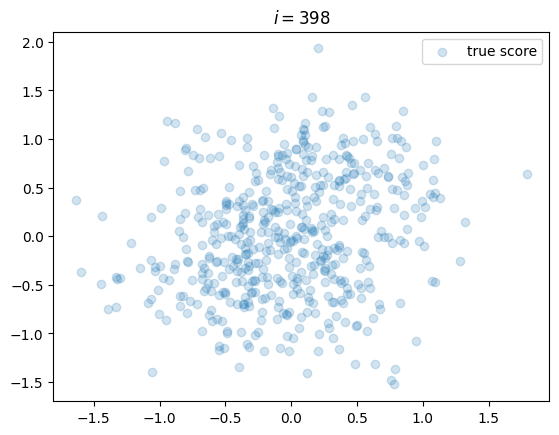

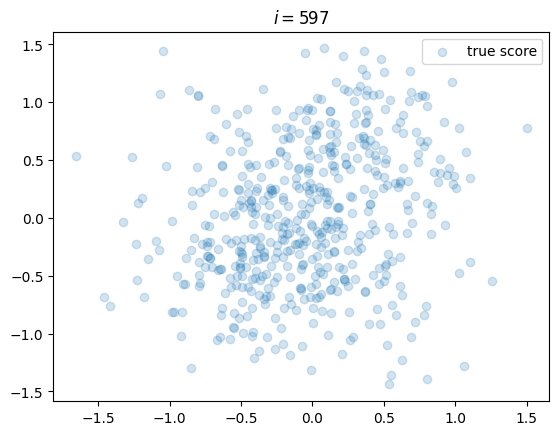

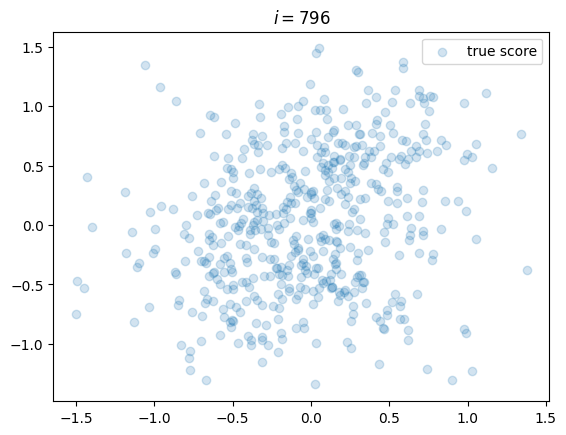

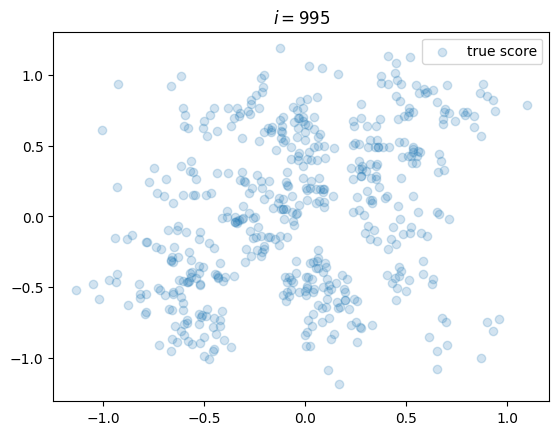

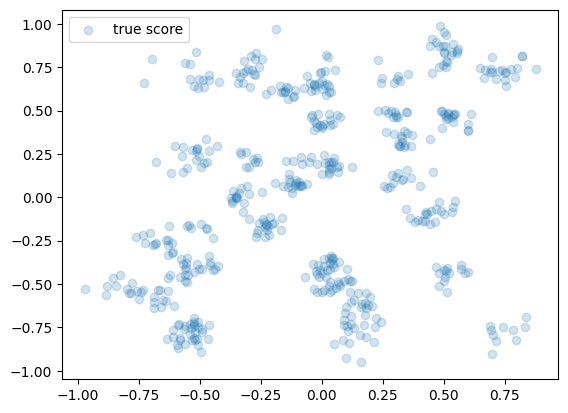

In [161]:
for i in range(0, model_samples.shape[0], 199):
    #plt.scatter(*model_samples[i].T.detach().cpu(), alpha=0.2, label='model')
    plt.scatter(*true_samples[i].T.detach().cpu(), alpha=0.2, label='true score')
    #plt.scatter(*samples[i].T.detach().cpu(), alpha=0.2, label='estimated score')
    plt.legend()
    plt.title(r'$i=%d$' % i)

    #plot_dataset(unnormalize(model_samples[i], global_mins_init, global_maxs_init))
    plt.show()
    
plt.scatter(*true_samples[-1].T.detach().cpu(), alpha=0.2, label='true score')
plt.legend()
plt.show()

ValueError: tensor([0.0000, 0.0010, 0.0020, 0.0030, 0.0040, 0.0050, 0.0060, 0.0070, 0.0080,
        0.0090, 0.0100, 0.0110, 0.0120, 0.0130, 0.0140, 0.0150, 0.0160, 0.0170,
        0.0180, 0.0190, 0.0200, 0.0210, 0.0220, 0.0230, 0.0240, 0.0250, 0.0260,
        0.0270, 0.0280, 0.0290, 0.0300, 0.0310, 0.0320, 0.0330, 0.0340, 0.0350,
        0.0360, 0.0370, 0.0380, 0.0390, 0.0400, 0.0410, 0.0420, 0.0430, 0.0440,
        0.0450, 0.0460, 0.0470, 0.0480, 0.0490, 0.0501, 0.0511, 0.0521, 0.0531,
        0.0541, 0.0551, 0.0561, 0.0571, 0.0581, 0.0591, 0.0601, 0.0611, 0.0621,
        0.0631, 0.0641, 0.0651, 0.0661, 0.0671, 0.0681, 0.0691, 0.0701, 0.0711,
        0.0721, 0.0731, 0.0741, 0.0751, 0.0761, 0.0771, 0.0781, 0.0791, 0.0801,
        0.0811, 0.0821, 0.0831, 0.0841, 0.0851, 0.0861, 0.0871, 0.0881, 0.0891,
        0.0901, 0.0911, 0.0921, 0.0931, 0.0941, 0.0951, 0.0961, 0.0971, 0.0981,
        0.0991, 0.1001, 0.1011, 0.1021, 0.1031, 0.1041, 0.1051, 0.1061, 0.1071,
        0.1081, 0.1091, 0.1101, 0.1111, 0.1121, 0.1131, 0.1141, 0.1151, 0.1161,
        0.1171, 0.1181, 0.1191, 0.1201, 0.1211, 0.1221, 0.1231, 0.1241, 0.1251,
        0.1261, 0.1271, 0.1281, 0.1291, 0.1301, 0.1311, 0.1321, 0.1331, 0.1341,
        0.1351, 0.1361, 0.1371, 0.1381, 0.1391, 0.1401, 0.1411, 0.1421, 0.1431,
        0.1441, 0.1451, 0.1461, 0.1471, 0.1481, 0.1491, 0.1502, 0.1512, 0.1522,
        0.1532, 0.1542, 0.1552, 0.1562, 0.1572, 0.1582, 0.1592, 0.1602, 0.1612,
        0.1622, 0.1632, 0.1642, 0.1652, 0.1662, 0.1672, 0.1682, 0.1692, 0.1702,
        0.1712, 0.1722, 0.1732, 0.1742, 0.1752, 0.1762, 0.1772, 0.1782, 0.1792,
        0.1802, 0.1812, 0.1822, 0.1832, 0.1842, 0.1852, 0.1862, 0.1872, 0.1882,
        0.1892, 0.1902, 0.1912, 0.1922, 0.1932, 0.1942, 0.1952, 0.1962, 0.1972,
        0.1982, 0.1992, 0.2002, 0.2012, 0.2022, 0.2032, 0.2042, 0.2052, 0.2062,
        0.2072, 0.2082, 0.2092, 0.2102, 0.2112, 0.2122, 0.2132, 0.2142, 0.2152,
        0.2162, 0.2172, 0.2182, 0.2192, 0.2202, 0.2212, 0.2222, 0.2232, 0.2242,
        0.2252, 0.2262, 0.2272, 0.2282, 0.2292, 0.2302, 0.2312, 0.2322, 0.2332,
        0.2342, 0.2352, 0.2362, 0.2372, 0.2382, 0.2392, 0.2402, 0.2412, 0.2422,
        0.2432, 0.2442, 0.2452, 0.2462, 0.2472, 0.2482, 0.2492, 0.2503, 0.2513,
        0.2523, 0.2533, 0.2543, 0.2553, 0.2563, 0.2573, 0.2583, 0.2593, 0.2603,
        0.2613, 0.2623, 0.2633, 0.2643, 0.2653, 0.2663, 0.2673, 0.2683, 0.2693,
        0.2703, 0.2713, 0.2723, 0.2733, 0.2743, 0.2753, 0.2763, 0.2773, 0.2783,
        0.2793, 0.2803, 0.2813, 0.2823, 0.2833, 0.2843, 0.2853, 0.2863, 0.2873,
        0.2883, 0.2893, 0.2903, 0.2913, 0.2923, 0.2933, 0.2943, 0.2953, 0.2963,
        0.2973, 0.2983, 0.2993, 0.3003, 0.3013, 0.3023, 0.3033, 0.3043, 0.3053,
        0.3063, 0.3073, 0.3083, 0.3093, 0.3103, 0.3113, 0.3123, 0.3133, 0.3143,
        0.3153, 0.3163, 0.3173, 0.3183, 0.3193, 0.3203, 0.3213, 0.3223, 0.3233,
        0.3243, 0.3253, 0.3263, 0.3273, 0.3283, 0.3293, 0.3303, 0.3313, 0.3323,
        0.3333, 0.3343, 0.3353, 0.3363, 0.3373, 0.3383, 0.3393, 0.3403, 0.3413,
        0.3423, 0.3433, 0.3443, 0.3453, 0.3463, 0.3473, 0.3483, 0.3493, 0.3504,
        0.3514, 0.3524, 0.3534, 0.3544, 0.3554, 0.3564, 0.3574, 0.3584, 0.3594,
        0.3604, 0.3614, 0.3624, 0.3634, 0.3644, 0.3654, 0.3664, 0.3674, 0.3684,
        0.3694, 0.3704, 0.3714, 0.3724, 0.3734, 0.3744, 0.3754, 0.3764, 0.3774,
        0.3784, 0.3794, 0.3804, 0.3814, 0.3824, 0.3834, 0.3844, 0.3854, 0.3864,
        0.3874, 0.3884, 0.3894, 0.3904, 0.3914, 0.3924, 0.3934, 0.3944, 0.3954,
        0.3964, 0.3974, 0.3984, 0.3994, 0.4004, 0.4014, 0.4024, 0.4034, 0.4044,
        0.4054, 0.4064, 0.4074, 0.4084, 0.4094, 0.4104, 0.4114, 0.4124, 0.4134,
        0.4144, 0.4154, 0.4164, 0.4174, 0.4184, 0.4194, 0.4204, 0.4214, 0.4224,
        0.4234, 0.4244, 0.4254, 0.4264, 0.4274, 0.4284, 0.4294, 0.4304, 0.4314,
        0.4324, 0.4334, 0.4344, 0.4354, 0.4364, 0.4374, 0.4384, 0.4394, 0.4404,
        0.4414, 0.4424, 0.4434, 0.4444, 0.4454, 0.4464, 0.4474, 0.4484, 0.4494,
        0.4505, 0.4515, 0.4525, 0.4535, 0.4545, 0.4555, 0.4565, 0.4575, 0.4585,
        0.4595, 0.4605, 0.4615, 0.4625, 0.4635, 0.4645, 0.4655, 0.4665, 0.4675,
        0.4685, 0.4695, 0.4705, 0.4715, 0.4725, 0.4735, 0.4745, 0.4755, 0.4765,
        0.4775, 0.4785, 0.4795, 0.4805, 0.4815, 0.4825, 0.4835, 0.4845, 0.4855,
        0.4865, 0.4875, 0.4885, 0.4895, 0.4905, 0.4915, 0.4925, 0.4935, 0.4945,
        0.4955, 0.4965, 0.4975, 0.4985, 0.4995, 0.5005, 0.5015, 0.5025, 0.5035,
        0.5045, 0.5055, 0.5065, 0.5075, 0.5085, 0.5095, 0.5105, 0.5115, 0.5125,
        0.5135, 0.5145, 0.5155, 0.5165, 0.5175, 0.5185, 0.5195, 0.5205, 0.5215,
        0.5225, 0.5235, 0.5245, 0.5255, 0.5265, 0.5275, 0.5285, 0.5295, 0.5305,
        0.5315, 0.5325, 0.5335, 0.5345, 0.5355, 0.5365, 0.5375, 0.5385, 0.5395,
        0.5405, 0.5415, 0.5425, 0.5435, 0.5445, 0.5455, 0.5465, 0.5475, 0.5485,
        0.5495, 0.5506, 0.5516, 0.5526, 0.5536, 0.5546, 0.5556, 0.5566, 0.5576,
        0.5586, 0.5596, 0.5606, 0.5616, 0.5626, 0.5636, 0.5646, 0.5656, 0.5666,
        0.5676, 0.5686, 0.5696, 0.5706, 0.5716, 0.5726, 0.5736, 0.5746, 0.5756,
        0.5766, 0.5776, 0.5786, 0.5796, 0.5806, 0.5816, 0.5826, 0.5836, 0.5846,
        0.5856, 0.5866, 0.5876, 0.5886, 0.5896, 0.5906, 0.5916, 0.5926, 0.5936,
        0.5946, 0.5956, 0.5966, 0.5976, 0.5986, 0.5996, 0.6006, 0.6016, 0.6026,
        0.6036, 0.6046, 0.6056, 0.6066, 0.6076, 0.6086, 0.6096, 0.6106, 0.6116,
        0.6126, 0.6136, 0.6146, 0.6156, 0.6166, 0.6176, 0.6186, 0.6196, 0.6206,
        0.6216, 0.6226, 0.6236, 0.6246, 0.6256, 0.6266, 0.6276, 0.6286, 0.6296,
        0.6306, 0.6316, 0.6326, 0.6336, 0.6346, 0.6356, 0.6366, 0.6376, 0.6386,
        0.6396, 0.6406, 0.6416, 0.6426, 0.6436, 0.6446, 0.6456, 0.6466, 0.6476,
        0.6486, 0.6496, 0.6507, 0.6517, 0.6527, 0.6537, 0.6547, 0.6557, 0.6567,
        0.6577, 0.6587, 0.6597, 0.6607, 0.6617, 0.6627, 0.6637, 0.6647, 0.6657,
        0.6667, 0.6677, 0.6687, 0.6697, 0.6707, 0.6717, 0.6727, 0.6737, 0.6747,
        0.6757, 0.6767, 0.6777, 0.6787, 0.6797, 0.6807, 0.6817, 0.6827, 0.6837,
        0.6847, 0.6857, 0.6867, 0.6877, 0.6887, 0.6897, 0.6907, 0.6917, 0.6927,
        0.6937, 0.6947, 0.6957, 0.6967, 0.6977, 0.6987, 0.6997, 0.7007, 0.7017,
        0.7027, 0.7037, 0.7047, 0.7057, 0.7067, 0.7077, 0.7087, 0.7097, 0.7107,
        0.7117, 0.7127, 0.7137, 0.7147, 0.7157, 0.7167, 0.7177, 0.7187, 0.7197,
        0.7207, 0.7217, 0.7227, 0.7237, 0.7247, 0.7257, 0.7267, 0.7277, 0.7287,
        0.7297, 0.7307, 0.7317, 0.7327, 0.7337, 0.7347, 0.7357, 0.7367, 0.7377,
        0.7387, 0.7397, 0.7407, 0.7417, 0.7427, 0.7437, 0.7447, 0.7457, 0.7467,
        0.7477, 0.7487, 0.7497, 0.7508, 0.7518, 0.7528, 0.7538, 0.7548, 0.7558,
        0.7568, 0.7578, 0.7588, 0.7598, 0.7608, 0.7618, 0.7628, 0.7638, 0.7648,
        0.7658, 0.7668, 0.7678, 0.7688, 0.7698, 0.7708, 0.7718, 0.7728, 0.7738,
        0.7748, 0.7758, 0.7768, 0.7778, 0.7788, 0.7798, 0.7808, 0.7818, 0.7828,
        0.7838, 0.7848, 0.7858, 0.7868, 0.7878, 0.7888, 0.7898, 0.7908, 0.7918,
        0.7928, 0.7938, 0.7948, 0.7958, 0.7968, 0.7978, 0.7988, 0.7998, 0.8008,
        0.8018, 0.8028, 0.8038, 0.8048, 0.8058, 0.8068, 0.8078, 0.8088, 0.8098,
        0.8108, 0.8118, 0.8128, 0.8138, 0.8148, 0.8158, 0.8168, 0.8178, 0.8188,
        0.8198, 0.8208, 0.8218, 0.8228, 0.8238, 0.8248, 0.8258, 0.8268, 0.8278,
        0.8288, 0.8298, 0.8308, 0.8318, 0.8328, 0.8338, 0.8348, 0.8358, 0.8368,
        0.8378, 0.8388, 0.8398, 0.8408, 0.8418, 0.8428, 0.8438, 0.8448, 0.8458,
        0.8468, 0.8478, 0.8488, 0.8498, 0.8509, 0.8519, 0.8529, 0.8539, 0.8549,
        0.8559, 0.8569, 0.8579, 0.8589, 0.8599, 0.8609, 0.8619, 0.8629, 0.8639,
        0.8649, 0.8659, 0.8669, 0.8679, 0.8689, 0.8699, 0.8709, 0.8719, 0.8729,
        0.8739, 0.8749, 0.8759, 0.8769, 0.8779, 0.8789, 0.8799, 0.8809, 0.8819,
        0.8829, 0.8839, 0.8849, 0.8859, 0.8869, 0.8879, 0.8889, 0.8899, 0.8909,
        0.8919, 0.8929, 0.8939, 0.8949, 0.8959, 0.8969, 0.8979, 0.8989, 0.8999,
        0.9009, 0.9019, 0.9029, 0.9039, 0.9049, 0.9059, 0.9069, 0.9079, 0.9089,
        0.9099, 0.9109, 0.9119, 0.9129, 0.9139, 0.9149, 0.9159, 0.9169, 0.9179,
        0.9189, 0.9199, 0.9209, 0.9219, 0.9229, 0.9239, 0.9249, 0.9259, 0.9269,
        0.9279, 0.9289, 0.9299, 0.9309, 0.9319, 0.9329, 0.9339, 0.9349, 0.9359,
        0.9369, 0.9379, 0.9389, 0.9399, 0.9409, 0.9419, 0.9429, 0.9439, 0.9449,
        0.9459, 0.9469, 0.9479, 0.9489, 0.9499, 0.9510, 0.9520, 0.9530, 0.9540,
        0.9550, 0.9560, 0.9570, 0.9580, 0.9590, 0.9600, 0.9610, 0.9620, 0.9630,
        0.9640, 0.9650, 0.9660, 0.9670, 0.9680, 0.9690, 0.9700, 0.9710, 0.9720,
        0.9730, 0.9740, 0.9750, 0.9760, 0.9770, 0.9780, 0.9790, 0.9800, 0.9810,
        0.9820, 0.9830, 0.9840, 0.9850, 0.9860, 0.9870, 0.9880, 0.9890, 0.9900,
        0.9910, 0.9920, 0.9930, 0.9940, 0.9950, 0.9960, 0.9970, 0.9980, 0.9990,
        1.0000]) is not a valid value for color

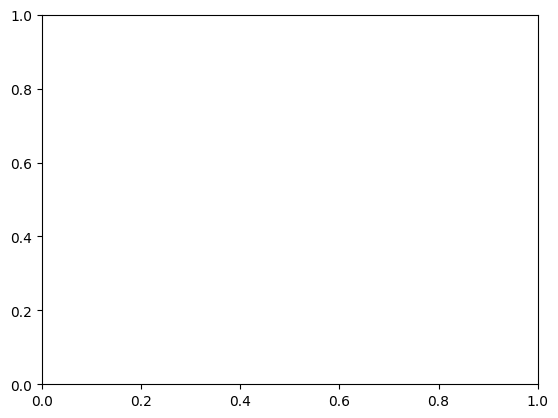

In [109]:
plt.plot(model_samples[:, 0, 0].detach().cpu(), model_samples[:,0,1].detach().cpu(), c=torch.linspace(0, 1, len(model_samples)))

### Training

In [98]:
def reward_matching_loss_biased(vectorfield, x, t, noise_schedule): 
    h_t = noise_schedule.h(t)
    #h_t = beta * t.unsqueeze(1)
    x.requires_grad = True

    # noisy sample: x(t)
    noisy_x = torch.normal(x, h_t.unsqueeze(1) ** 0.5)
    pred_scores = vectorfield(noisy_x, t)

    estimated_scores = estimate_grad_Rt(noisy_x, t, noise_schedule) * (h_t + 1e-3).unsqueeze(1)
    #estimated_scores = true_grad_Rt(x, t, noise_schedule) * (h_t + 5e-3).unsqueeze(1)
    #norm = torch.linalg.vector_norm(estimated_scores, dim=-1)
    #print(norm.max())
    #max_norm = 100
    #clip_coef = torch.clamp(max_norm / (norm+1e-6), max=1)
    #estimated_scores = estimated_scores * clip_coef.unsqueeze(-1)
    

    return ((estimated_scores - pred_scores)**2) / ((h_t + 1e-3).unsqueeze(1))

In [86]:
def score_loss(vectorfield, x, t):
    h_t = beta * t.unsqueeze(1)
    # x(t)
    x_t = torch.normal(x, h_t ** 0.5)
    s_pred = vectorfield(x_t, t)

    s_true = - (x_t - x)/ h_t 
    return ((s_pred - s_true)**2) / ((h_t + 1e-2))#.mean()    

In [87]:
import torch.distributions as dist
class LogUniform(dist.TransformedDistribution):
    def __init__(self, lb, ub):
        super(LogUniform, self).__init__(dist.Uniform(lb.log(), ub.log()),
                                         dist.ExpTransform())

In [99]:
beta = 0.2
vectorfield = MyMLP(add_t_emb=False, concat_t_emb=True).to(device)

In [100]:
#vectorfield.load_state_dict(torch.load('/mnt/user_storage/long_trained_reward_matching_gmm.pt'))

In [101]:
opt_vectorfield = Adam(vectorfield.parameters(), lr=1e-3)

In [102]:
# buffer = SimpleBuffer(2, 10000, 1000, initial_sampler=None, 
#                       device=device, fill_buffer_during_init=False, sample_with_replacement=True)
buffer = SimpleBuffer(2, 10000, 1000, initial_sampler=None, 
                      device=device, fill_buffer_during_init=False, 
                      sample_with_replacement=True, prioritize=True)

# x1_energy = target.log_prob(x1_samples).detach()
# buffer.add(x1_samples_normalized, x1_energy)
buffer.add(init_samples, init_energy)

Buffer not initialised, expected that checkpoint will be loaded.


In [103]:
outer_epochs= 10000
inner_epochs = 10

num_samples = 2048 

#train_dataset = TensorDataset(x1_samples_normalized.clone(), x1_energy.clone())
train_dataset = TensorDataset(init_samples.clone(), init_energy.clone())
trainloader = DataLoader(train_dataset, batch_size = 512, shuffle=True) 
global_mins, global_maxs = global_mins_init, global_maxs_init

In [104]:
init_num_samples = 2048
unnorm_true_samples = (
    target.sample(torch.tensor(init_num_samples).unsqueeze(0)).to(device).detach()
)
unnorm_init_samples = flow.sample((init_num_samples,)).to(device).detach()
init_energy = target.log_prob(unnorm_init_samples).detach()
init_samples, global_mins_init, global_maxs_init = normalize(unnorm_true_samples)

global_mins_init = -50
global_maxs_init = 50

init_dataset = TensorDataset(init_samples, init_energy)
init_loader = DataLoader(init_dataset, batch_size=512, shuffle=True)

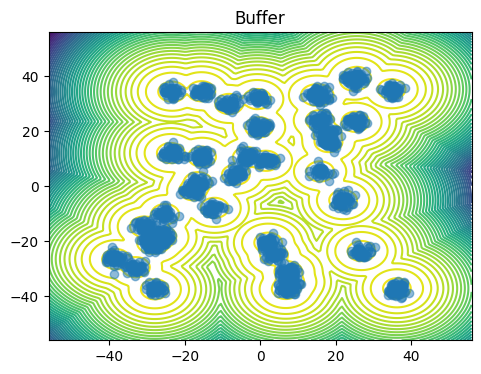

[<Figure size 1200x400 with 1 Axes>]

In [105]:
plot_dataset(unnormalize(init_samples, global_mins, global_maxs))

  0%|          | 0/10000 [00:00<?, ?it/s]

Epoch 0 | Loss 0.164374


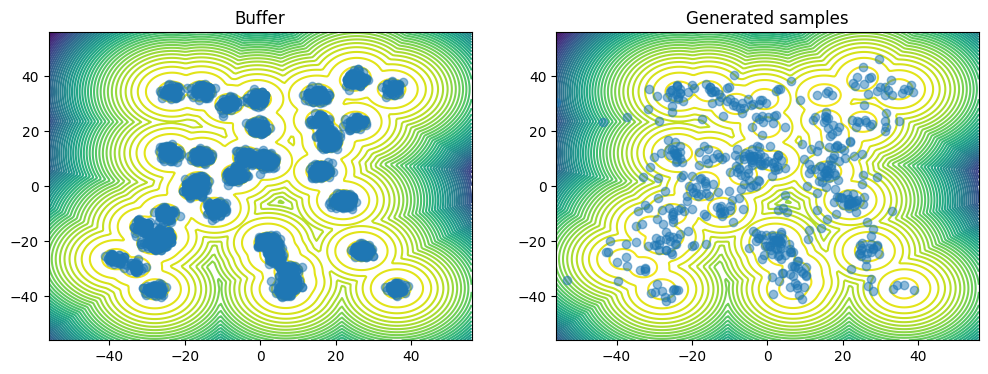

  0%|          | 1/10000 [00:04<12:35:27,  4.53s/it]

Epoch 0 | Loss 0.261089


  0%|          | 2/10000 [00:08<11:04:48,  3.99s/it]

Epoch 0 | Loss 0.131023


  0%|          | 3/10000 [00:11<10:36:57,  3.82s/it]

Epoch 0 | Loss 0.117596


  0%|          | 4/10000 [00:15<10:41:23,  3.85s/it]

Epoch 0 | Loss 0.181100


  0%|          | 5/10000 [00:19<10:25:02,  3.75s/it]

Epoch 0 | Loss 0.137003


  0%|          | 6/10000 [00:22<10:15:49,  3.70s/it]

Epoch 0 | Loss 0.341655


  0%|          | 7/10000 [00:26<10:10:04,  3.66s/it]

Epoch 0 | Loss 0.194943


  0%|          | 8/10000 [00:29<10:04:44,  3.63s/it]

Epoch 0 | Loss 0.166363


  0%|          | 9/10000 [00:33<10:01:56,  3.61s/it]

Epoch 0 | Loss 0.146382


  0%|          | 10/10000 [00:37<9:59:43,  3.60s/it]

Epoch 0 | Loss 0.128861


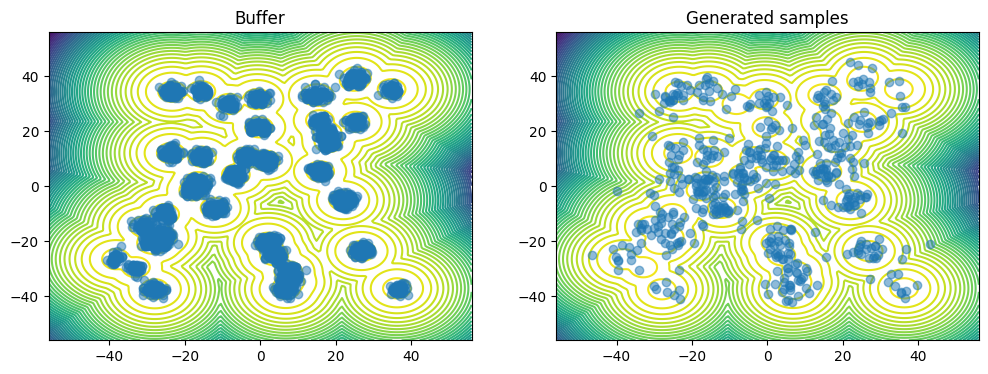

  0%|          | 11/10000 [00:41<10:44:42,  3.87s/it]

Epoch 0 | Loss 0.173125


  0%|          | 12/10000 [00:45<10:30:48,  3.79s/it]

Epoch 0 | Loss 0.229108


  0%|          | 13/10000 [00:49<10:33:48,  3.81s/it]

Epoch 0 | Loss 0.128079


  0%|          | 14/10000 [00:52<10:27:20,  3.77s/it]

Epoch 0 | Loss 0.177750


  0%|          | 15/10000 [00:56<10:19:59,  3.73s/it]

Epoch 0 | Loss 0.161284


  0%|          | 16/10000 [00:59<10:13:53,  3.69s/it]

Epoch 0 | Loss 0.170726


  0%|          | 17/10000 [01:03<10:09:32,  3.66s/it]

Epoch 0 | Loss 0.176414


  0%|          | 18/10000 [01:07<10:10:27,  3.67s/it]

Epoch 0 | Loss 0.168205


  0%|          | 19/10000 [01:10<10:11:27,  3.68s/it]

Epoch 0 | Loss 0.287732


  0%|          | 20/10000 [01:14<10:07:47,  3.65s/it]

Epoch 0 | Loss 1.651792


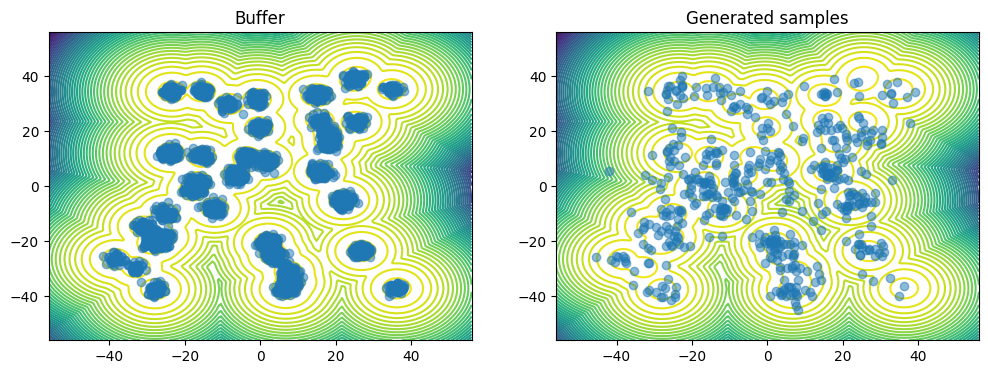

  0%|          | 21/10000 [01:19<11:03:22,  3.99s/it]

Epoch 0 | Loss 0.114967


  0%|          | 22/10000 [01:22<10:43:29,  3.87s/it]

Epoch 0 | Loss 0.135131


  0%|          | 23/10000 [01:26<10:28:59,  3.78s/it]

Epoch 0 | Loss 0.124058


  0%|          | 24/10000 [01:30<10:18:20,  3.72s/it]

Epoch 0 | Loss 0.168898


  0%|          | 25/10000 [01:33<10:11:11,  3.68s/it]

Epoch 0 | Loss 0.193620


  0%|          | 26/10000 [01:37<10:07:26,  3.65s/it]

Epoch 0 | Loss 0.149423


  0%|          | 27/10000 [01:40<10:05:05,  3.64s/it]

Epoch 0 | Loss 0.129380


  0%|          | 28/10000 [01:44<10:04:43,  3.64s/it]

Epoch 0 | Loss 0.087171


  0%|          | 29/10000 [01:48<10:03:47,  3.63s/it]

Epoch 0 | Loss 0.141867


  0%|          | 30/10000 [01:51<10:02:17,  3.62s/it]

Epoch 0 | Loss 0.237713


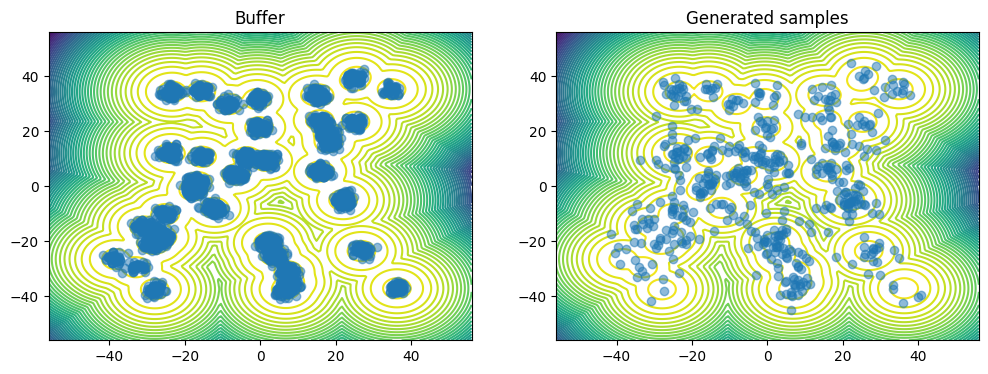

  0%|          | 31/10000 [01:56<10:59:30,  3.97s/it]

Epoch 0 | Loss 0.131353


  0%|          | 32/10000 [02:00<10:40:24,  3.85s/it]

Epoch 0 | Loss 0.102469


  0%|          | 33/10000 [02:03<10:27:04,  3.77s/it]

Epoch 0 | Loss 0.138748


  0%|          | 34/10000 [02:07<10:17:23,  3.72s/it]

Epoch 0 | Loss 0.198467


  0%|          | 35/10000 [02:10<10:11:46,  3.68s/it]

Epoch 0 | Loss 0.213123


  0%|          | 36/10000 [02:14<10:07:34,  3.66s/it]

Epoch 0 | Loss 0.142489


  0%|          | 37/10000 [02:18<10:05:27,  3.65s/it]

Epoch 0 | Loss 0.165273


  0%|          | 38/10000 [02:21<10:03:45,  3.64s/it]

Epoch 0 | Loss 0.202603


  0%|          | 39/10000 [02:25<10:02:29,  3.63s/it]

Epoch 0 | Loss 0.205575


  0%|          | 40/10000 [02:28<10:01:39,  3.62s/it]

Epoch 0 | Loss 0.168153


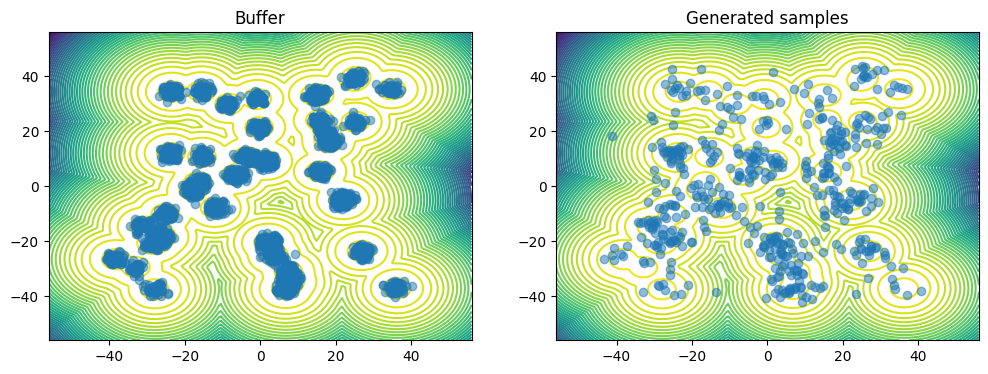

  0%|          | 41/10000 [02:33<10:59:08,  3.97s/it]

Epoch 0 | Loss 0.118573


  0%|          | 42/10000 [02:37<10:41:05,  3.86s/it]

Epoch 0 | Loss 0.666426


  0%|          | 43/10000 [02:40<10:27:28,  3.78s/it]

Epoch 0 | Loss 0.225225


  0%|          | 44/10000 [02:44<10:18:53,  3.73s/it]

Epoch 0 | Loss 0.096753


  0%|          | 45/10000 [02:48<10:11:07,  3.68s/it]

Epoch 0 | Loss 0.128047


  0%|          | 46/10000 [02:51<10:08:01,  3.66s/it]

Epoch 0 | Loss 0.158123


  0%|          | 47/10000 [02:55<10:09:24,  3.67s/it]

Epoch 0 | Loss 0.081505


  0%|          | 48/10000 [02:58<10:05:37,  3.65s/it]

Epoch 0 | Loss 0.082890


  0%|          | 49/10000 [03:02<10:03:02,  3.64s/it]

Epoch 0 | Loss 0.134867


  0%|          | 50/10000 [03:06<10:01:39,  3.63s/it]

Epoch 0 | Loss 0.158528


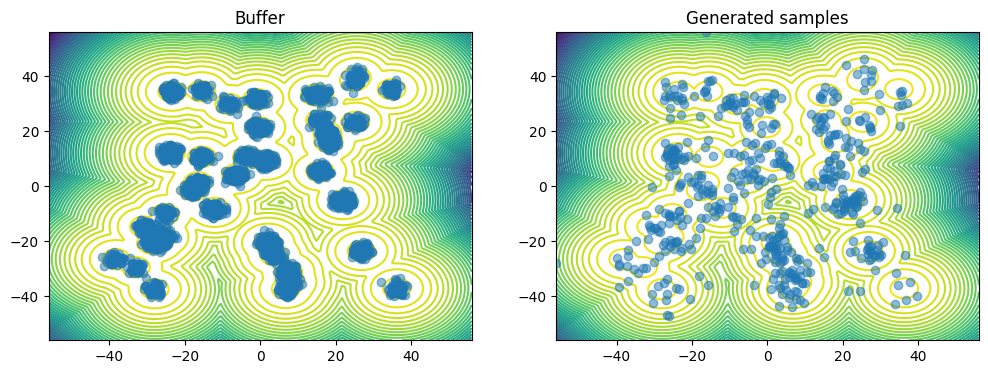

  1%|          | 51/10000 [03:11<11:04:34,  4.01s/it]

Epoch 0 | Loss 0.142347


  1%|          | 52/10000 [03:15<11:04:41,  4.01s/it]

Epoch 0 | Loss 0.148924


  1%|          | 53/10000 [03:18<10:42:58,  3.88s/it]

Epoch 0 | Loss 0.324368


  1%|          | 54/10000 [03:22<10:28:08,  3.79s/it]

Epoch 0 | Loss 0.193190


  1%|          | 55/10000 [03:25<10:18:11,  3.73s/it]

Epoch 0 | Loss 0.826470


  1%|          | 56/10000 [03:29<10:10:56,  3.69s/it]

Epoch 0 | Loss 0.163065


  1%|          | 57/10000 [03:33<10:05:01,  3.65s/it]

Epoch 0 | Loss 0.075358


  1%|          | 58/10000 [03:36<10:14:51,  3.71s/it]

Epoch 0 | Loss 0.199863


  1%|          | 59/10000 [03:40<10:08:22,  3.67s/it]

Epoch 0 | Loss 0.282386


  1%|          | 60/10000 [03:44<10:07:52,  3.67s/it]

Epoch 0 | Loss 0.119306


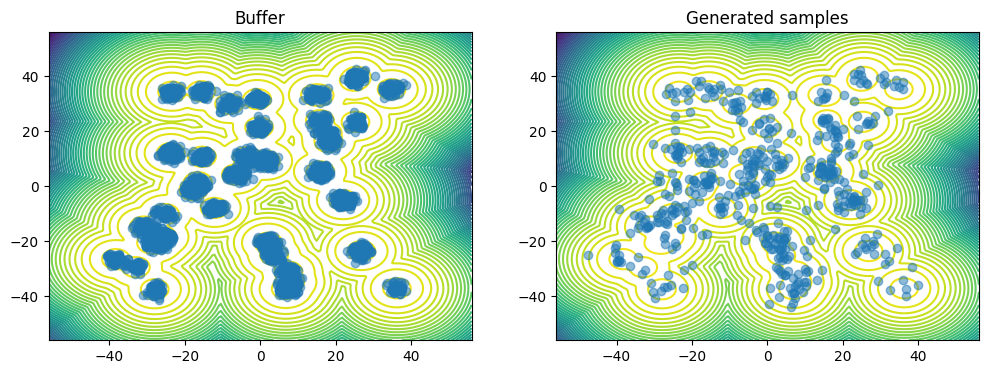

  1%|          | 61/10000 [03:48<10:48:19,  3.91s/it]

Epoch 0 | Loss 0.115468


  1%|          | 62/10000 [03:52<10:33:14,  3.82s/it]

Epoch 0 | Loss 0.157925


  1%|          | 63/10000 [03:55<10:20:52,  3.75s/it]

Epoch 0 | Loss 3.962984


  1%|          | 64/10000 [03:59<10:13:34,  3.71s/it]

Epoch 0 | Loss 0.351702


  1%|          | 65/10000 [04:02<10:07:51,  3.67s/it]

Epoch 0 | Loss 0.176705


  1%|          | 66/10000 [04:06<10:03:58,  3.65s/it]

Epoch 0 | Loss 0.162391


  1%|          | 67/10000 [04:10<10:01:04,  3.63s/it]

Epoch 0 | Loss 0.154010


  1%|          | 68/10000 [04:14<10:13:09,  3.70s/it]

Epoch 0 | Loss 0.393104


  1%|          | 69/10000 [04:17<10:06:49,  3.67s/it]

Epoch 0 | Loss 0.225556


  1%|          | 70/10000 [04:21<10:03:19,  3.65s/it]

Epoch 0 | Loss 0.145258


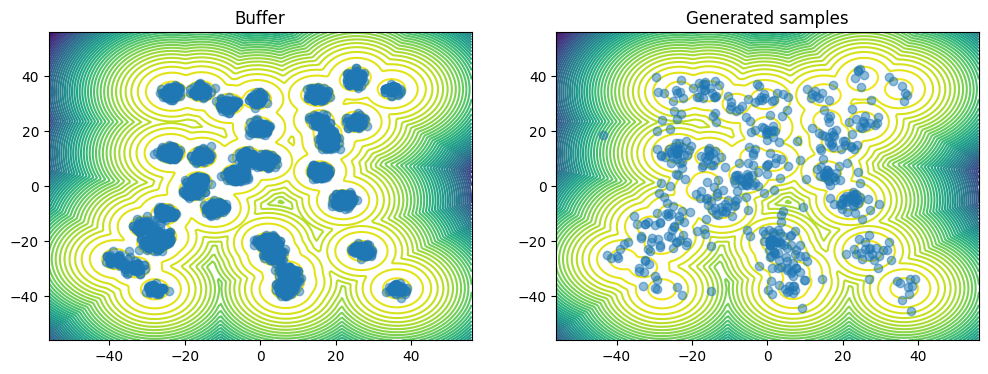

  1%|          | 71/10000 [04:25<10:44:42,  3.90s/it]

Epoch 0 | Loss 0.572398


  1%|          | 72/10000 [04:29<10:31:42,  3.82s/it]

Epoch 0 | Loss 0.299087


  1%|          | 73/10000 [04:32<10:20:12,  3.75s/it]

Epoch 0 | Loss 0.124108


  1%|          | 74/10000 [04:36<10:11:43,  3.70s/it]

Epoch 0 | Loss 0.203136


  1%|          | 75/10000 [04:40<10:07:32,  3.67s/it]

Epoch 0 | Loss 0.127913


  1%|          | 76/10000 [04:43<10:16:43,  3.73s/it]

Epoch 0 | Loss 0.206219


  1%|          | 77/10000 [04:47<10:09:18,  3.68s/it]

Epoch 0 | Loss 0.124798


  1%|          | 78/10000 [04:51<10:04:18,  3.65s/it]

Epoch 0 | Loss 0.118575


  1%|          | 79/10000 [04:54<10:00:11,  3.63s/it]

Epoch 0 | Loss 0.329418


  1%|          | 80/10000 [04:58<10:02:43,  3.65s/it]

Epoch 0 | Loss 0.114384


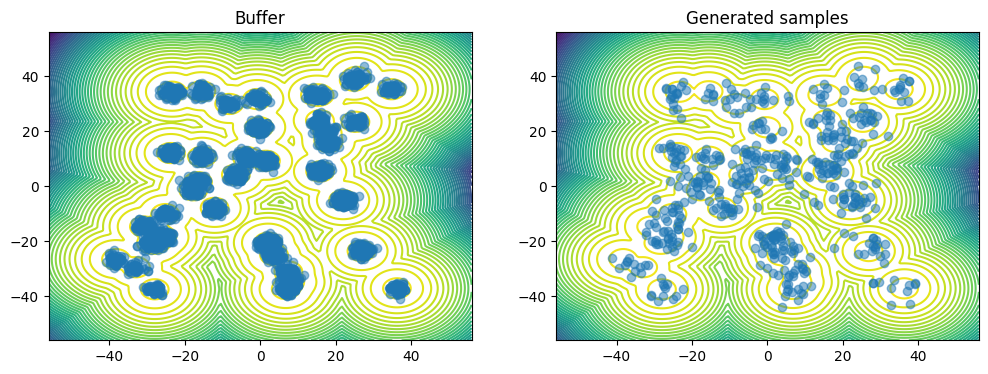

  1%|          | 81/10000 [05:02<10:44:07,  3.90s/it]

Epoch 0 | Loss 0.165862


  1%|          | 82/10000 [05:06<10:29:58,  3.81s/it]

Epoch 0 | Loss 0.201604


  1%|          | 83/10000 [05:10<10:22:10,  3.76s/it]

Epoch 0 | Loss 0.122602


  1%|          | 84/10000 [05:14<10:28:45,  3.80s/it]

Epoch 0 | Loss 0.185750


  1%|          | 85/10000 [05:17<10:18:03,  3.74s/it]

Epoch 0 | Loss 0.423199


  1%|          | 86/10000 [05:21<10:10:12,  3.69s/it]

Epoch 0 | Loss 0.353886


  1%|          | 87/10000 [05:24<10:05:01,  3.66s/it]

Epoch 0 | Loss 0.091816


  1%|          | 88/10000 [05:28<10:01:40,  3.64s/it]

Epoch 0 | Loss 0.106935


  1%|          | 89/10000 [05:31<9:59:03,  3.63s/it] 

Epoch 0 | Loss 0.443650


  1%|          | 90/10000 [05:35<9:58:06,  3.62s/it]

Epoch 0 | Loss 0.089185


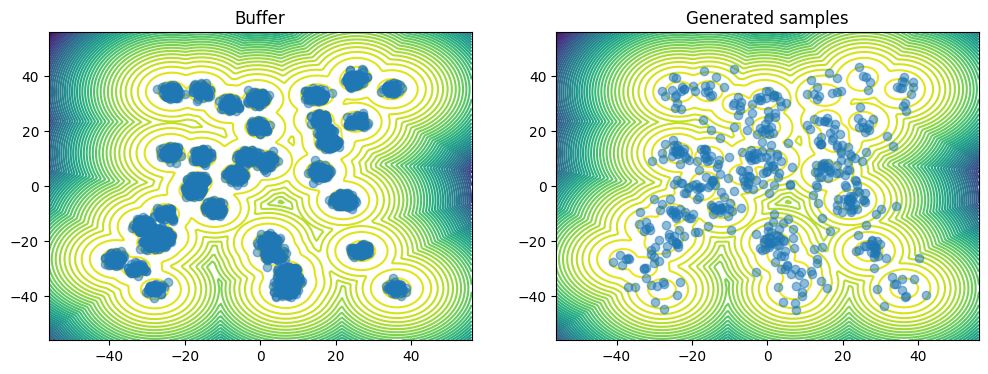

  1%|          | 91/10000 [05:40<10:41:59,  3.89s/it]

Epoch 0 | Loss 0.143761


  1%|          | 92/10000 [05:43<10:26:39,  3.79s/it]

Epoch 0 | Loss 0.229603


  1%|          | 93/10000 [05:47<10:15:03,  3.72s/it]

Epoch 0 | Loss 0.490131


  1%|          | 94/10000 [05:51<10:24:12,  3.78s/it]

Epoch 0 | Loss 0.086280


  1%|          | 95/10000 [05:54<10:13:50,  3.72s/it]

Epoch 0 | Loss 0.156300


  1%|          | 96/10000 [05:58<10:06:11,  3.67s/it]

Epoch 0 | Loss 0.109302


  1%|          | 97/10000 [06:01<10:00:42,  3.64s/it]

Epoch 0 | Loss 0.465385


  1%|          | 98/10000 [06:05<9:57:42,  3.62s/it] 

Epoch 0 | Loss 0.100518


  1%|          | 99/10000 [06:09<9:56:02,  3.61s/it]

Epoch 0 | Loss 0.407117


  1%|          | 100/10000 [06:12<9:54:46,  3.60s/it]

Epoch 0 | Loss 0.095577


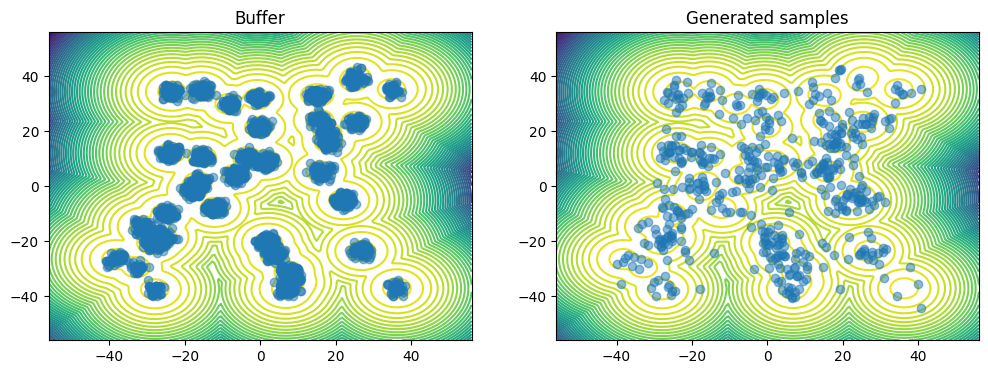

  1%|          | 101/10000 [06:17<10:50:11,  3.94s/it]

Epoch 0 | Loss 0.170659


  1%|          | 102/10000 [06:20<10:32:08,  3.83s/it]

Epoch 0 | Loss 0.416741


  1%|          | 103/10000 [06:24<10:20:34,  3.76s/it]

Epoch 0 | Loss 0.312286


  1%|          | 104/10000 [06:28<10:10:38,  3.70s/it]

Epoch 0 | Loss 0.143451


  1%|          | 105/10000 [06:31<10:05:10,  3.67s/it]

Epoch 0 | Loss 0.171297


  1%|          | 106/10000 [06:35<10:01:52,  3.65s/it]

Epoch 0 | Loss 0.178451


  1%|          | 107/10000 [06:38<9:57:47,  3.63s/it] 

Epoch 0 | Loss 0.117641


  1%|          | 108/10000 [06:42<9:55:31,  3.61s/it]

Epoch 0 | Loss 0.069099


  1%|          | 109/10000 [06:45<9:53:03,  3.60s/it]

Epoch 0 | Loss 0.165863


  1%|          | 110/10000 [06:49<9:51:13,  3.59s/it]

Epoch 0 | Loss 0.092659


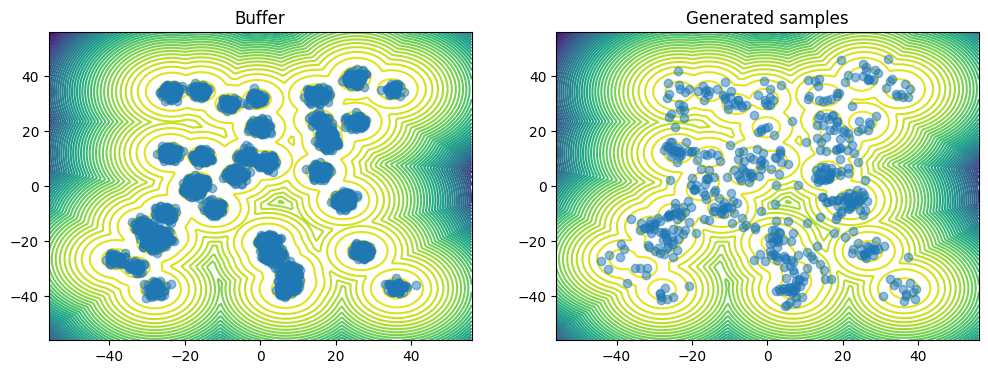

  1%|          | 111/10000 [06:54<10:49:15,  3.94s/it]

Epoch 0 | Loss 0.403754


  1%|          | 112/10000 [06:58<10:41:19,  3.89s/it]

Epoch 0 | Loss 0.078405


  1%|          | 113/10000 [07:01<10:26:26,  3.80s/it]

Epoch 0 | Loss 0.182257


  1%|          | 114/10000 [07:05<10:15:11,  3.73s/it]

Epoch 0 | Loss 0.176627


  1%|          | 115/10000 [07:08<10:06:29,  3.68s/it]

Epoch 0 | Loss 0.204448


  1%|          | 116/10000 [07:12<10:02:54,  3.66s/it]

Epoch 0 | Loss 0.114192


  1%|          | 117/10000 [07:16<10:02:05,  3.66s/it]

Epoch 0 | Loss 0.089474


  1%|          | 118/10000 [07:19<9:57:52,  3.63s/it] 

Epoch 0 | Loss 0.110378


  1%|          | 119/10000 [07:23<9:54:52,  3.61s/it]

Epoch 0 | Loss 0.096268


  1%|          | 120/10000 [07:26<9:56:45,  3.62s/it]

Epoch 0 | Loss 0.184069


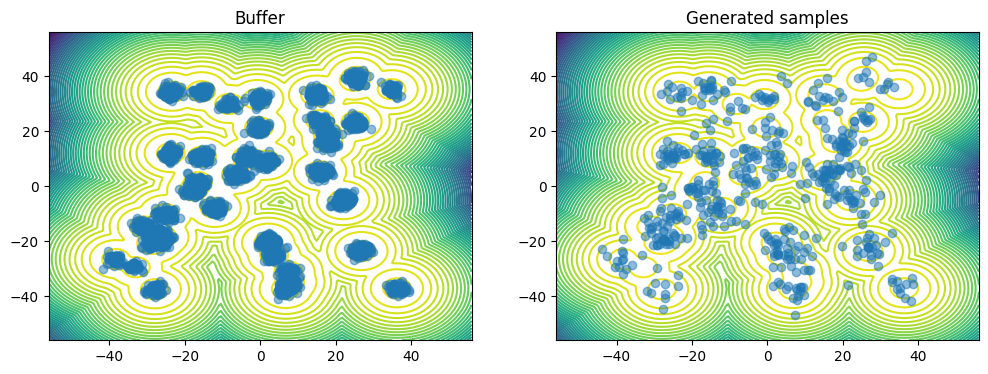

  1%|          | 121/10000 [07:31<10:54:55,  3.98s/it]

Epoch 0 | Loss 0.135861


  1%|          | 122/10000 [07:35<10:34:14,  3.85s/it]

Epoch 0 | Loss 0.333006


  1%|          | 123/10000 [07:38<10:19:53,  3.77s/it]

Epoch 0 | Loss 0.117571


  1%|          | 124/10000 [07:42<10:11:46,  3.72s/it]

Epoch 0 | Loss 0.659484


  1%|▏         | 125/10000 [07:45<10:04:28,  3.67s/it]

Epoch 0 | Loss 0.115459


  1%|▏         | 126/10000 [07:49<9:58:58,  3.64s/it] 

Epoch 0 | Loss 0.111882


  1%|▏         | 127/10000 [07:53<9:55:13,  3.62s/it]

Epoch 0 | Loss 0.118331


  1%|▏         | 128/10000 [07:56<9:52:37,  3.60s/it]

Epoch 0 | Loss 0.100388


  1%|▏         | 129/10000 [08:00<9:51:11,  3.59s/it]

Epoch 0 | Loss 0.110227


  1%|▏         | 130/10000 [08:03<9:50:06,  3.59s/it]

Epoch 0 | Loss 0.384174


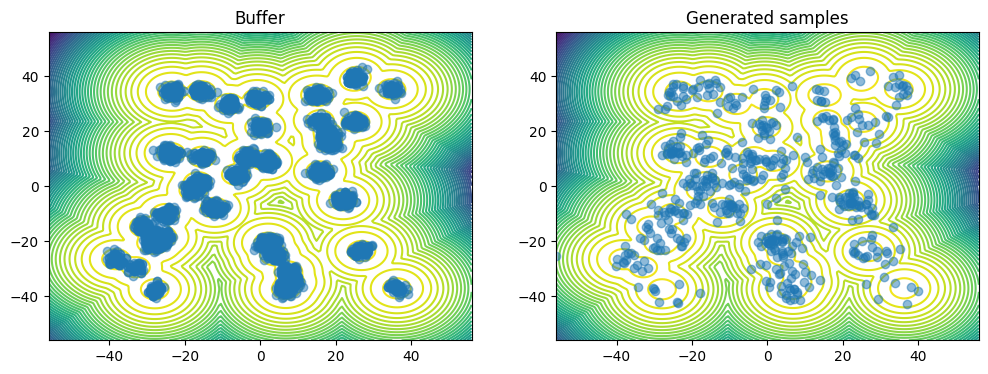

  1%|▏         | 131/10000 [08:08<10:46:38,  3.93s/it]

Epoch 0 | Loss 0.119772


  1%|▏         | 132/10000 [08:12<10:31:02,  3.84s/it]

Epoch 0 | Loss 0.150796


  1%|▏         | 133/10000 [08:15<10:19:22,  3.77s/it]

Epoch 0 | Loss 0.101828


  1%|▏         | 134/10000 [08:19<10:19:14,  3.77s/it]

Epoch 0 | Loss 0.098256


  1%|▏         | 135/10000 [08:23<10:29:06,  3.83s/it]

Epoch 0 | Loss 0.154405


  1%|▏         | 136/10000 [08:27<10:17:42,  3.76s/it]

Epoch 0 | Loss 0.145125


  1%|▏         | 137/10000 [08:30<10:08:29,  3.70s/it]

Epoch 0 | Loss 0.075660


  1%|▏         | 138/10000 [08:34<10:01:41,  3.66s/it]

Epoch 0 | Loss 0.115045


  1%|▏         | 139/10000 [08:37<9:57:30,  3.64s/it] 

Epoch 0 | Loss 0.093206


  1%|▏         | 140/10000 [08:41<9:55:25,  3.62s/it]

Epoch 0 | Loss 0.139142


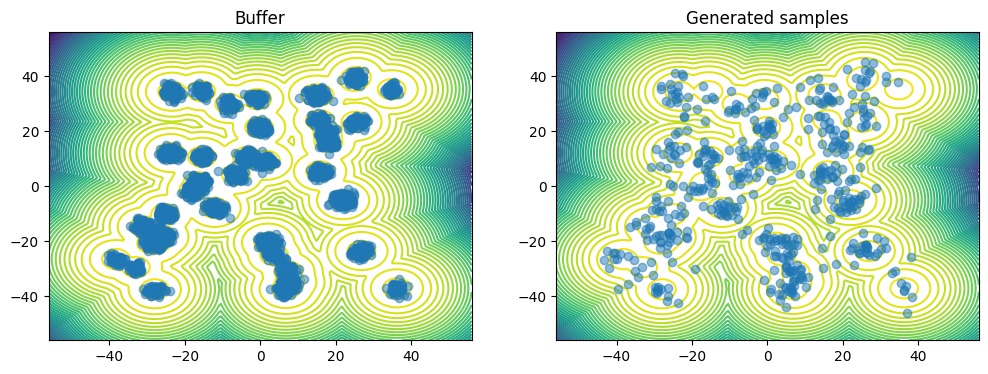

  1%|▏         | 141/10000 [08:46<10:57:24,  4.00s/it]

Epoch 0 | Loss 0.156996


  1%|▏         | 142/10000 [08:49<10:36:26,  3.87s/it]

Epoch 0 | Loss 0.147609


  1%|▏         | 143/10000 [08:53<10:21:23,  3.78s/it]

Epoch 0 | Loss 0.153993


  1%|▏         | 144/10000 [08:56<10:10:32,  3.72s/it]

Epoch 0 | Loss 0.420060


  1%|▏         | 145/10000 [09:00<10:10:58,  3.72s/it]

Epoch 0 | Loss 0.152713


  1%|▏         | 146/10000 [09:04<10:08:05,  3.70s/it]

Epoch 0 | Loss 0.148085


  1%|▏         | 147/10000 [09:08<10:05:22,  3.69s/it]

Epoch 0 | Loss 0.143054


  1%|▏         | 148/10000 [09:11<10:04:39,  3.68s/it]

Epoch 0 | Loss 0.133901


  1%|▏         | 149/10000 [09:15<9:58:58,  3.65s/it] 

Epoch 0 | Loss 0.118586


  2%|▏         | 150/10000 [09:18<9:54:51,  3.62s/it]

Epoch 0 | Loss 0.131309


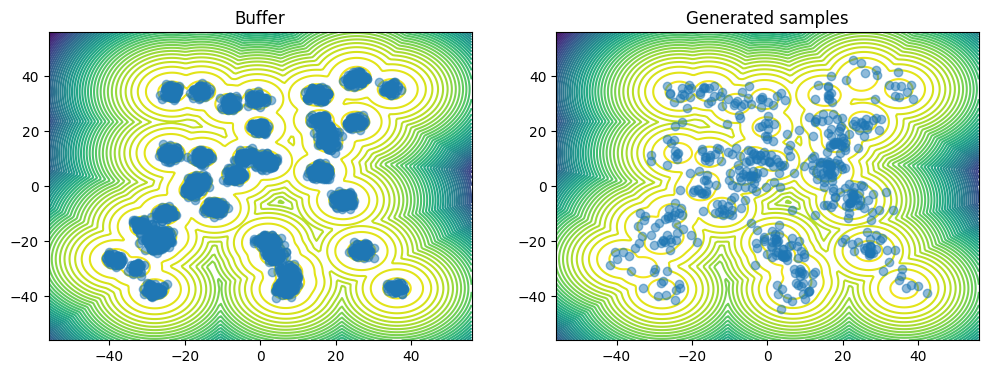

  2%|▏         | 151/10000 [09:23<10:51:12,  3.97s/it]

Epoch 0 | Loss 0.156256


  2%|▏         | 152/10000 [09:27<10:32:32,  3.85s/it]

Epoch 0 | Loss 0.541230


  2%|▏         | 153/10000 [09:30<10:18:52,  3.77s/it]

Epoch 0 | Loss 0.215289


  2%|▏         | 154/10000 [09:34<10:09:23,  3.71s/it]

Epoch 0 | Loss 0.320027


  2%|▏         | 155/10000 [09:37<10:01:50,  3.67s/it]

Epoch 0 | Loss 0.195486


  2%|▏         | 156/10000 [09:41<9:58:10,  3.65s/it] 

Epoch 0 | Loss 0.083578


  2%|▏         | 157/10000 [09:45<9:54:34,  3.62s/it]

Epoch 0 | Loss 0.118839


  2%|▏         | 158/10000 [09:48<10:06:39,  3.70s/it]

Epoch 0 | Loss 0.104107


  2%|▏         | 159/10000 [09:52<10:01:22,  3.67s/it]

Epoch 0 | Loss 0.414694


  2%|▏         | 160/10000 [09:56<9:57:04,  3.64s/it] 

Epoch 0 | Loss 0.141149


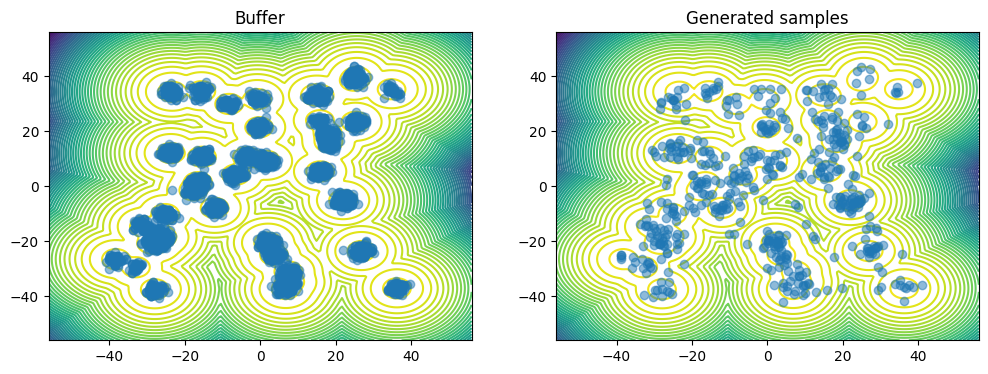

  2%|▏         | 161/10000 [10:00<10:41:58,  3.91s/it]

Epoch 0 | Loss 0.109109


  2%|▏         | 162/10000 [10:04<10:25:24,  3.81s/it]

Epoch 0 | Loss 0.126139


  2%|▏         | 163/10000 [10:07<10:14:51,  3.75s/it]

Epoch 0 | Loss 0.177945


  2%|▏         | 164/10000 [10:11<10:08:27,  3.71s/it]

Epoch 0 | Loss 0.224703


  2%|▏         | 165/10000 [10:15<10:00:41,  3.66s/it]

Epoch 0 | Loss 0.253856


  2%|▏         | 166/10000 [10:18<10:09:25,  3.72s/it]

Epoch 0 | Loss 0.151042


  2%|▏         | 167/10000 [10:22<10:01:47,  3.67s/it]

Epoch 0 | Loss 0.119230


  2%|▏         | 168/10000 [10:25<9:56:30,  3.64s/it] 

Epoch 0 | Loss 0.171373


  2%|▏         | 169/10000 [10:29<9:52:16,  3.61s/it]

Epoch 0 | Loss 0.194369


  2%|▏         | 170/10000 [10:33<9:49:48,  3.60s/it]

Epoch 0 | Loss 0.079612


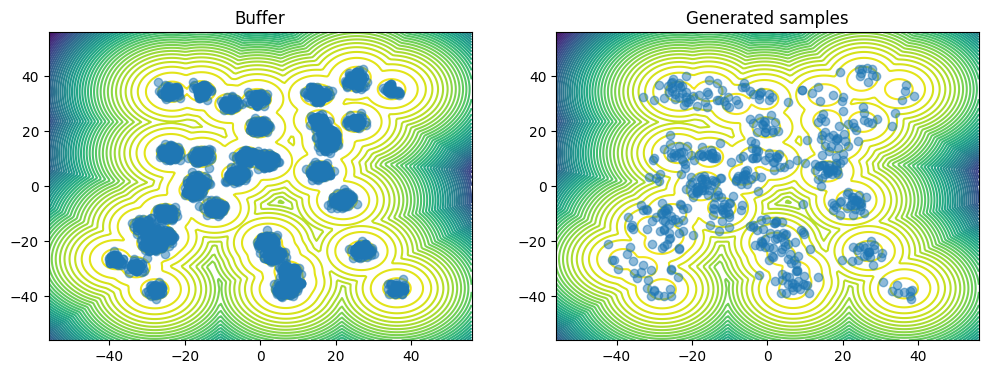

  2%|▏         | 171/10000 [10:37<10:31:58,  3.86s/it]

Epoch 0 | Loss 0.195758


  2%|▏         | 172/10000 [10:41<10:18:01,  3.77s/it]

Epoch 0 | Loss 0.077397


  2%|▏         | 173/10000 [10:45<10:24:07,  3.81s/it]

Epoch 0 | Loss 0.142747


  2%|▏         | 174/10000 [10:48<10:11:55,  3.74s/it]

Epoch 0 | Loss 0.117615


  2%|▏         | 175/10000 [10:52<10:03:57,  3.69s/it]

Epoch 0 | Loss 0.086863


  2%|▏         | 176/10000 [10:55<9:57:43,  3.65s/it] 

Epoch 0 | Loss 0.106286


  2%|▏         | 177/10000 [10:59<9:57:48,  3.65s/it]

Epoch 0 | Loss 0.128384


  2%|▏         | 178/10000 [11:03<10:00:27,  3.67s/it]

Epoch 0 | Loss 0.098044


  2%|▏         | 179/10000 [11:06<9:56:04,  3.64s/it] 

Epoch 0 | Loss 0.154119


  2%|▏         | 180/10000 [11:10<9:52:08,  3.62s/it]

Epoch 0 | Loss 0.202768


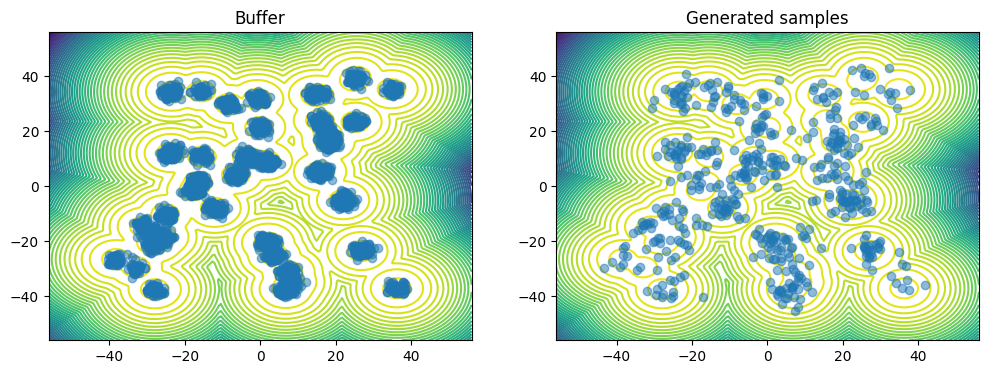

  2%|▏         | 181/10000 [11:15<10:51:08,  3.98s/it]

Epoch 0 | Loss 0.123967


  2%|▏         | 182/10000 [11:18<10:30:54,  3.86s/it]

Epoch 0 | Loss 0.278799


  2%|▏         | 183/10000 [11:22<10:17:53,  3.78s/it]

Epoch 0 | Loss 0.793323


  2%|▏         | 184/10000 [11:25<10:07:53,  3.72s/it]

Epoch 0 | Loss 0.211482


  2%|▏         | 185/10000 [11:29<10:00:52,  3.67s/it]

Epoch 0 | Loss 0.096638


  2%|▏         | 186/10000 [11:32<9:55:22,  3.64s/it] 

Epoch 0 | Loss 0.093957


  2%|▏         | 187/10000 [11:36<9:52:27,  3.62s/it]

Epoch 0 | Loss 0.107598


  2%|▏         | 188/10000 [11:40<9:50:28,  3.61s/it]

Epoch 0 | Loss 0.161892


  2%|▏         | 189/10000 [11:43<9:49:51,  3.61s/it]

Epoch 0 | Loss 0.114732


  2%|▏         | 190/10000 [11:47<9:47:57,  3.60s/it]

Epoch 0 | Loss 0.085742


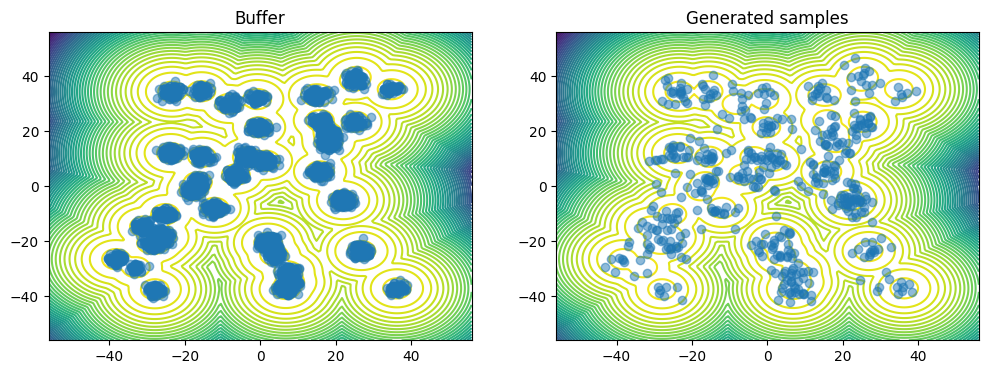

  2%|▏         | 191/10000 [11:52<10:45:10,  3.95s/it]

Epoch 0 | Loss 0.197883


  2%|▏         | 192/10000 [11:55<10:28:10,  3.84s/it]

Epoch 0 | Loss 0.143120


  2%|▏         | 193/10000 [11:59<10:16:28,  3.77s/it]

Epoch 0 | Loss 0.109809


  2%|▏         | 194/10000 [12:02<10:07:52,  3.72s/it]

Epoch 0 | Loss 0.080033


  2%|▏         | 195/10000 [12:06<10:02:20,  3.69s/it]

Epoch 0 | Loss 0.102237


  2%|▏         | 196/10000 [12:10<9:56:51,  3.65s/it] 

Epoch 0 | Loss 0.152834


  2%|▏         | 197/10000 [12:13<9:55:13,  3.64s/it]

Epoch 0 | Loss 0.191988


  2%|▏         | 198/10000 [12:17<9:51:47,  3.62s/it]

Epoch 0 | Loss 0.161784


  2%|▏         | 199/10000 [12:20<9:54:14,  3.64s/it]

Epoch 0 | Loss 0.200175


  2%|▏         | 200/10000 [12:24<9:52:28,  3.63s/it]

Epoch 0 | Loss 0.174184


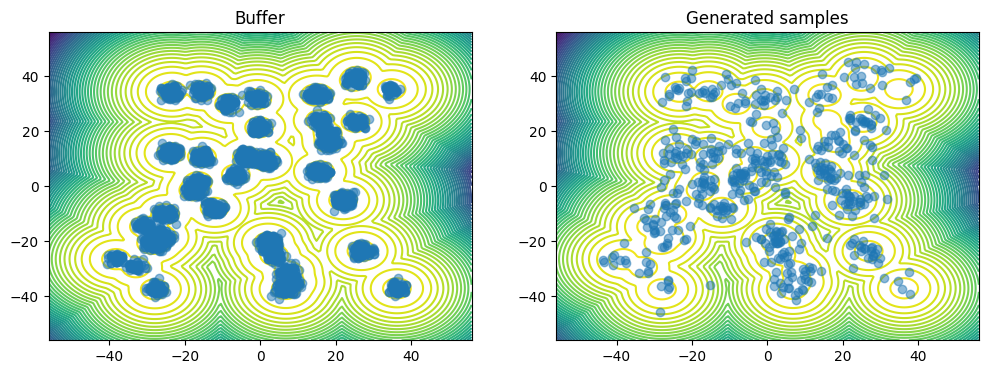

  2%|▏         | 201/10000 [12:29<10:51:24,  3.99s/it]

Epoch 0 | Loss 0.111979


  2%|▏         | 202/10000 [12:32<10:31:33,  3.87s/it]

Epoch 0 | Loss 0.114163


  2%|▏         | 203/10000 [12:36<10:17:11,  3.78s/it]

Epoch 0 | Loss 0.155328


  2%|▏         | 204/10000 [12:40<10:07:02,  3.72s/it]

Epoch 0 | Loss 0.091394


  2%|▏         | 205/10000 [12:43<10:01:31,  3.68s/it]

Epoch 0 | Loss 0.364729


  2%|▏         | 206/10000 [12:47<9:57:18,  3.66s/it] 

Epoch 0 | Loss 0.096104


  2%|▏         | 207/10000 [12:50<9:53:09,  3.63s/it]

Epoch 0 | Loss 0.117274


  2%|▏         | 208/10000 [12:54<9:50:16,  3.62s/it]

Epoch 0 | Loss 0.238872


  2%|▏         | 209/10000 [12:57<9:47:49,  3.60s/it]

Epoch 0 | Loss 0.248840


  2%|▏         | 210/10000 [13:01<9:46:29,  3.59s/it]

Epoch 0 | Loss 0.079495


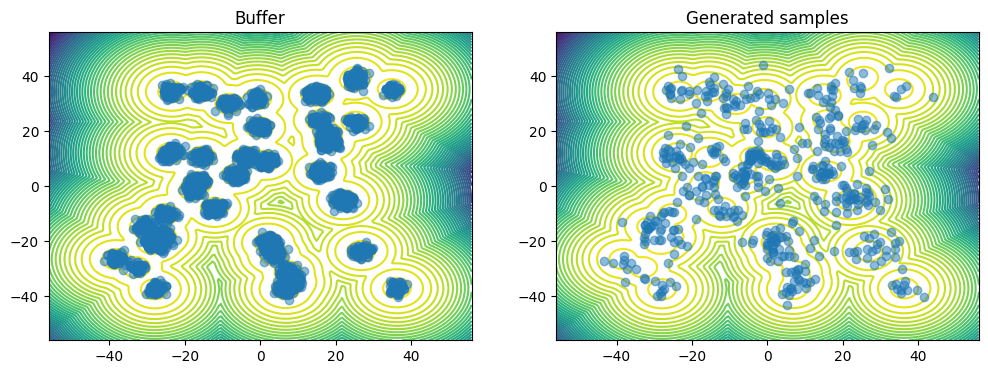

  2%|▏         | 211/10000 [13:06<10:55:44,  4.02s/it]

Epoch 0 | Loss 1.102344


  2%|▏         | 212/10000 [13:10<10:33:51,  3.89s/it]

Epoch 0 | Loss 0.121204


  2%|▏         | 213/10000 [13:13<10:23:51,  3.82s/it]

Epoch 0 | Loss 0.695583


  2%|▏         | 214/10000 [13:17<10:12:02,  3.75s/it]

Epoch 0 | Loss 0.192064


  2%|▏         | 215/10000 [13:20<10:03:07,  3.70s/it]

Epoch 0 | Loss 0.246302


  2%|▏         | 216/10000 [13:24<9:57:25,  3.66s/it] 

Epoch 0 | Loss 0.126743


  2%|▏         | 217/10000 [13:28<9:56:15,  3.66s/it]

Epoch 0 | Loss 0.176903


  2%|▏         | 218/10000 [13:31<9:59:37,  3.68s/it]

Epoch 0 | Loss 0.499468


  2%|▏         | 219/10000 [13:35<9:54:22,  3.65s/it]

Epoch 0 | Loss 0.194759


  2%|▏         | 220/10000 [13:39<9:54:35,  3.65s/it]

Epoch 0 | Loss 0.128924


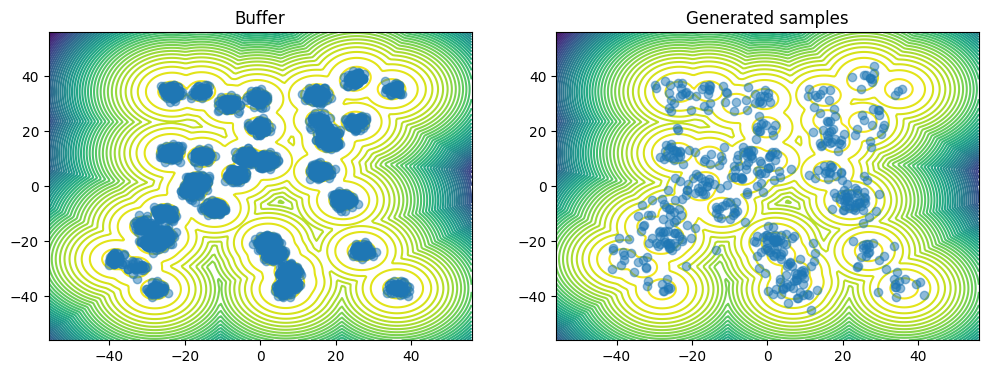

  2%|▏         | 221/10000 [13:43<10:51:32,  4.00s/it]

Epoch 0 | Loss 0.105561


  2%|▏         | 222/10000 [13:47<10:31:40,  3.88s/it]

Epoch 0 | Loss 0.089014


  2%|▏         | 223/10000 [13:51<10:16:53,  3.79s/it]

Epoch 0 | Loss 0.069274


  2%|▏         | 224/10000 [13:54<10:06:43,  3.72s/it]

Epoch 0 | Loss 0.178905


  2%|▏         | 225/10000 [13:58<10:00:35,  3.69s/it]

Epoch 0 | Loss 0.103076


  2%|▏         | 226/10000 [14:01<9:59:27,  3.68s/it] 

Epoch 0 | Loss 0.295087


  2%|▏         | 227/10000 [14:05<9:56:12,  3.66s/it]

Epoch 0 | Loss 0.178379


  2%|▏         | 228/10000 [14:09<9:53:11,  3.64s/it]

Epoch 0 | Loss 0.158588


  2%|▏         | 229/10000 [14:12<9:50:57,  3.63s/it]

Epoch 0 | Loss 0.403360


  2%|▏         | 230/10000 [14:16<9:48:46,  3.62s/it]

Epoch 0 | Loss 0.136455


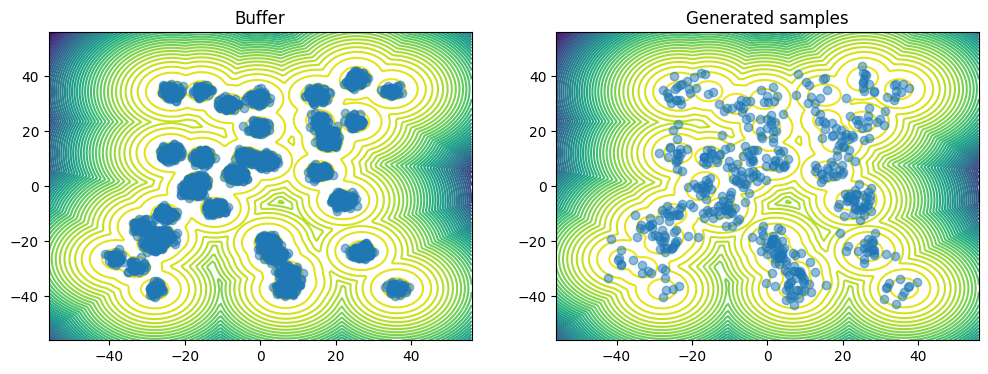

  2%|▏         | 231/10000 [14:21<10:45:10,  3.96s/it]

Epoch 0 | Loss 0.161455


  2%|▏         | 232/10000 [14:24<10:27:39,  3.86s/it]

Epoch 0 | Loss 0.198196


  2%|▏         | 233/10000 [14:28<10:13:45,  3.77s/it]

Epoch 0 | Loss 0.158291


  2%|▏         | 234/10000 [14:31<10:05:22,  3.72s/it]

Epoch 0 | Loss 0.142773


  2%|▏         | 235/10000 [14:35<9:58:56,  3.68s/it] 

Epoch 0 | Loss 0.117879


  2%|▏         | 236/10000 [14:39<9:53:31,  3.65s/it]

Epoch 0 | Loss 0.103229


  2%|▏         | 237/10000 [14:42<9:50:44,  3.63s/it]

Epoch 0 | Loss 0.172809


  2%|▏         | 238/10000 [14:46<9:47:06,  3.61s/it]

Epoch 0 | Loss 0.709931


  2%|▏         | 239/10000 [14:49<9:45:21,  3.60s/it]

Epoch 0 | Loss 0.106672


  2%|▏         | 240/10000 [14:53<9:43:46,  3.59s/it]

Epoch 0 | Loss 0.105620


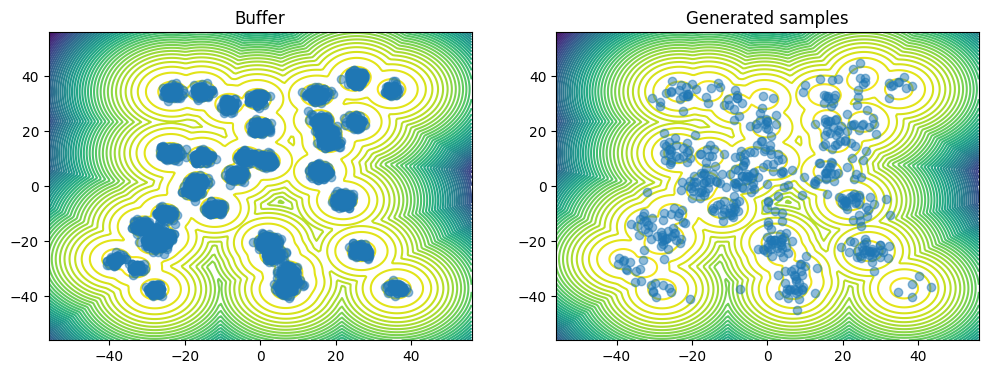

  2%|▏         | 241/10000 [14:58<10:42:20,  3.95s/it]

Epoch 0 | Loss 0.132078


  2%|▏         | 242/10000 [15:01<10:24:58,  3.84s/it]

Epoch 0 | Loss 0.110441


  2%|▏         | 243/10000 [15:05<10:14:15,  3.78s/it]

Epoch 0 | Loss 0.098574


  2%|▏         | 244/10000 [15:09<10:12:23,  3.77s/it]

Epoch 0 | Loss 0.121298


  2%|▏         | 245/10000 [15:12<10:08:17,  3.74s/it]

Epoch 0 | Loss 0.128316


  2%|▏         | 246/10000 [15:16<10:01:24,  3.70s/it]

Epoch 0 | Loss 1.574256


  2%|▏         | 247/10000 [15:20<9:56:55,  3.67s/it] 

Epoch 0 | Loss 0.121437


  2%|▏         | 248/10000 [15:23<9:52:38,  3.65s/it]

Epoch 0 | Loss 0.110784


  2%|▏         | 249/10000 [15:27<9:49:36,  3.63s/it]

Epoch 0 | Loss 0.168332


  2%|▎         | 250/10000 [15:30<9:48:11,  3.62s/it]

Epoch 0 | Loss 0.113722


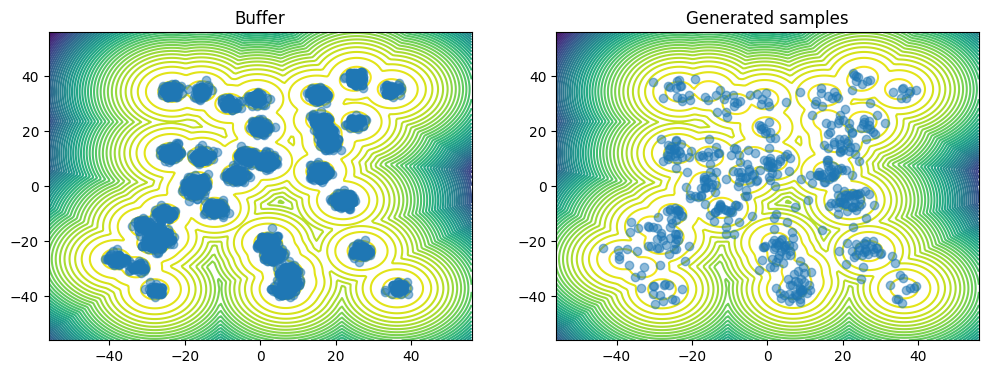

  3%|▎         | 251/10000 [15:35<10:46:35,  3.98s/it]

Epoch 0 | Loss 0.652229


  3%|▎         | 252/10000 [15:39<10:28:35,  3.87s/it]

Epoch 0 | Loss 0.157602


  3%|▎         | 253/10000 [15:42<10:15:03,  3.79s/it]

Epoch 0 | Loss 0.193052


  3%|▎         | 254/10000 [15:46<10:05:04,  3.73s/it]

Epoch 0 | Loss 0.081380


  3%|▎         | 255/10000 [15:50<9:58:52,  3.69s/it] 

Epoch 0 | Loss 0.102122


  3%|▎         | 256/10000 [15:53<9:53:54,  3.66s/it]

Epoch 0 | Loss 0.110871


  3%|▎         | 257/10000 [15:57<9:50:09,  3.63s/it]

Epoch 0 | Loss 0.067732


  3%|▎         | 258/10000 [16:00<9:46:51,  3.61s/it]

Epoch 0 | Loss 0.242334


  3%|▎         | 259/10000 [16:04<9:46:06,  3.61s/it]

Epoch 0 | Loss 0.395351


  3%|▎         | 260/10000 [16:07<9:43:44,  3.60s/it]

Epoch 0 | Loss 0.148461


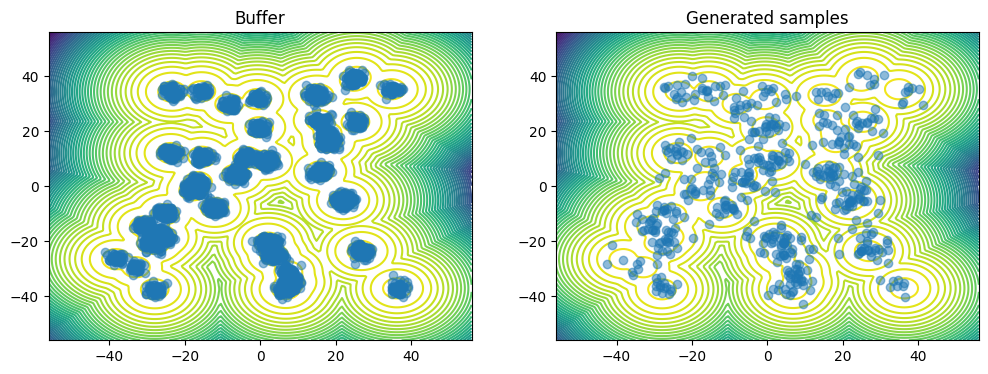

  3%|▎         | 261/10000 [16:12<10:44:18,  3.97s/it]

Epoch 0 | Loss 0.296085


  3%|▎         | 262/10000 [16:16<10:25:23,  3.85s/it]

Epoch 0 | Loss 0.085347


  3%|▎         | 263/10000 [16:19<10:12:00,  3.77s/it]

Epoch 0 | Loss 0.146872


  3%|▎         | 264/10000 [16:23<10:02:47,  3.71s/it]

Epoch 0 | Loss 0.070663


  3%|▎         | 265/10000 [16:27<9:56:02,  3.67s/it] 

Epoch 0 | Loss 0.140276


  3%|▎         | 266/10000 [16:30<9:50:56,  3.64s/it]

Epoch 0 | Loss 0.085645


  3%|▎         | 267/10000 [16:34<9:47:34,  3.62s/it]

Epoch 0 | Loss 0.145633


  3%|▎         | 268/10000 [16:37<9:46:02,  3.61s/it]

Epoch 0 | Loss 0.119931


  3%|▎         | 269/10000 [16:41<9:44:50,  3.61s/it]

Epoch 0 | Loss 0.130240


  3%|▎         | 270/10000 [16:45<9:44:40,  3.61s/it]

Epoch 0 | Loss 0.739780


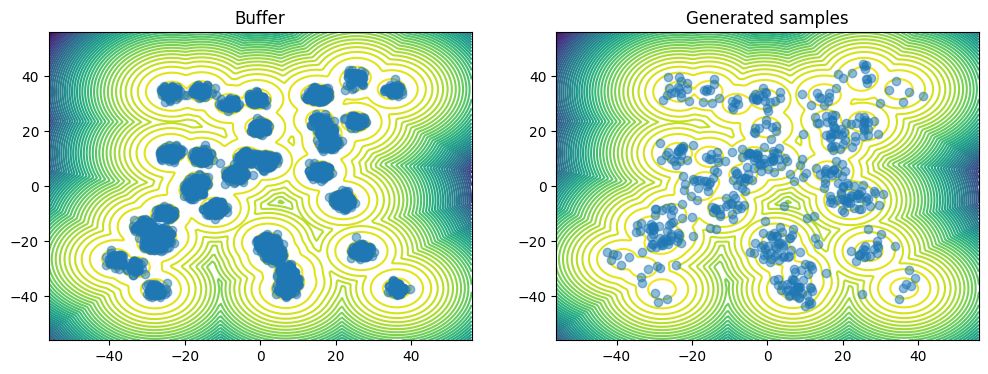

  3%|▎         | 271/10000 [16:49<10:42:35,  3.96s/it]

Epoch 0 | Loss 0.136682


  3%|▎         | 272/10000 [16:53<10:23:27,  3.85s/it]

Epoch 0 | Loss 0.331520


  3%|▎         | 273/10000 [16:56<10:10:15,  3.76s/it]

Epoch 0 | Loss 0.096026


  3%|▎         | 274/10000 [17:00<10:01:23,  3.71s/it]

Epoch 0 | Loss 0.188585


  3%|▎         | 275/10000 [17:04<9:54:24,  3.67s/it] 

Epoch 0 | Loss 0.353253


  3%|▎         | 276/10000 [17:07<9:54:11,  3.67s/it]

Epoch 0 | Loss 0.116987


  3%|▎         | 277/10000 [17:11<9:59:37,  3.70s/it]

Epoch 0 | Loss 0.104277


  3%|▎         | 278/10000 [17:15<9:57:41,  3.69s/it]

Epoch 0 | Loss 0.142441


  3%|▎         | 279/10000 [17:18<9:53:39,  3.66s/it]

Epoch 0 | Loss 0.153739


  3%|▎         | 280/10000 [17:22<9:49:41,  3.64s/it]

Epoch 0 | Loss 0.169752


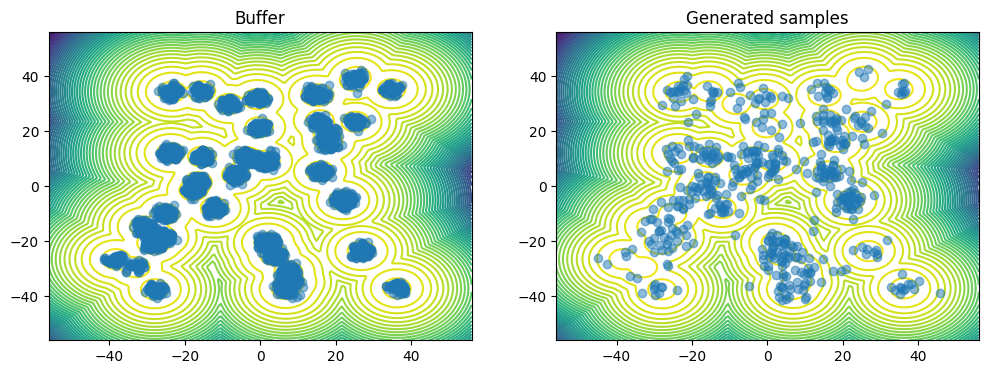

  3%|▎         | 281/10000 [17:27<10:45:13,  3.98s/it]

Epoch 0 | Loss 0.144158


  3%|▎         | 282/10000 [17:30<10:25:12,  3.86s/it]

Epoch 0 | Loss 0.115814


  3%|▎         | 283/10000 [17:34<10:12:34,  3.78s/it]

Epoch 0 | Loss 0.186484


  3%|▎         | 284/10000 [17:37<10:03:17,  3.73s/it]

Epoch 0 | Loss 0.115946


  3%|▎         | 285/10000 [17:41<9:58:30,  3.70s/it] 

Epoch 0 | Loss 0.083421


  3%|▎         | 286/10000 [17:45<9:53:17,  3.66s/it]

Epoch 0 | Loss 0.209066


  3%|▎         | 287/10000 [17:48<9:48:38,  3.64s/it]

Epoch 0 | Loss 0.089914


  3%|▎         | 288/10000 [17:52<9:45:49,  3.62s/it]

Epoch 0 | Loss 0.074120


  3%|▎         | 289/10000 [17:55<9:44:00,  3.61s/it]

Epoch 0 | Loss 0.211581


  3%|▎         | 290/10000 [17:59<9:43:42,  3.61s/it]

Epoch 0 | Loss 0.409518


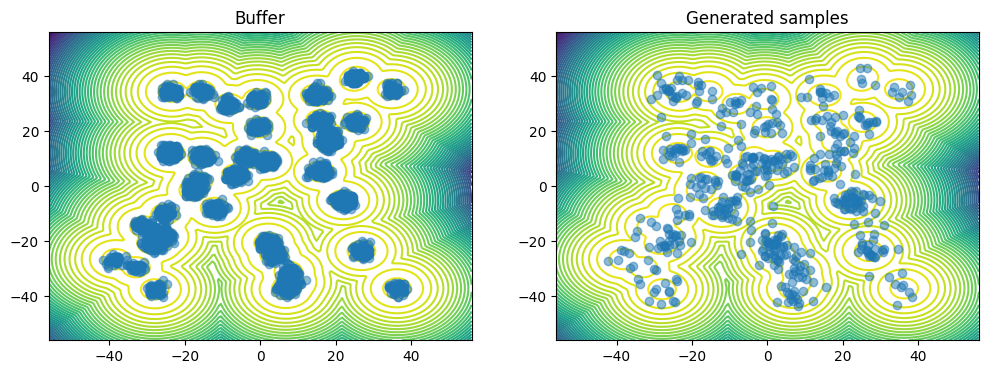

  3%|▎         | 291/10000 [18:03<10:27:06,  3.88s/it]

Epoch 0 | Loss 0.104003


  3%|▎         | 292/10000 [18:07<10:28:34,  3.88s/it]

Epoch 0 | Loss 0.117371


  3%|▎         | 293/10000 [18:11<10:14:36,  3.80s/it]

Epoch 0 | Loss 0.180914


  3%|▎         | 294/10000 [18:15<10:03:36,  3.73s/it]

Epoch 0 | Loss 0.196236


  3%|▎         | 295/10000 [18:18<9:55:00,  3.68s/it] 

Epoch 0 | Loss 0.096982


  3%|▎         | 296/10000 [18:22<9:49:29,  3.64s/it]

Epoch 0 | Loss 0.098914


  3%|▎         | 297/10000 [18:25<9:46:49,  3.63s/it]

Epoch 0 | Loss 0.137155


  3%|▎         | 298/10000 [18:29<9:45:10,  3.62s/it]

Epoch 0 | Loss 0.462306


  3%|▎         | 299/10000 [18:32<9:44:19,  3.61s/it]

Epoch 0 | Loss 0.076466


  3%|▎         | 300/10000 [18:36<9:43:55,  3.61s/it]

Epoch 0 | Loss 0.092033


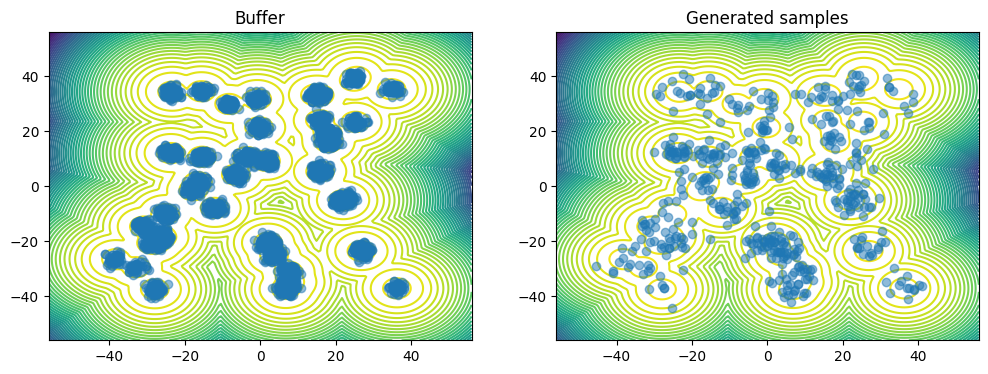

  3%|▎         | 301/10000 [18:41<10:39:06,  3.95s/it]

Epoch 0 | Loss 0.163750


  3%|▎         | 302/10000 [18:44<10:22:01,  3.85s/it]

Epoch 0 | Loss 0.076498


  3%|▎         | 303/10000 [18:48<10:10:04,  3.77s/it]

Epoch 0 | Loss 0.795496


  3%|▎         | 304/10000 [18:52<10:01:24,  3.72s/it]

Epoch 0 | Loss 0.082058


  3%|▎         | 305/10000 [18:55<9:56:01,  3.69s/it] 

Epoch 0 | Loss 0.070383


  3%|▎         | 306/10000 [18:59<10:07:37,  3.76s/it]

Epoch 0 | Loss 0.199069


  3%|▎         | 307/10000 [19:03<9:58:09,  3.70s/it] 

Epoch 0 | Loss 0.100153


  3%|▎         | 308/10000 [19:06<9:51:35,  3.66s/it]

Epoch 0 | Loss 0.241842


  3%|▎         | 309/10000 [19:10<10:03:26,  3.74s/it]

Epoch 0 | Loss 0.071363


  3%|▎         | 310/10000 [19:14<9:58:08,  3.70s/it] 

Epoch 0 | Loss 0.150743


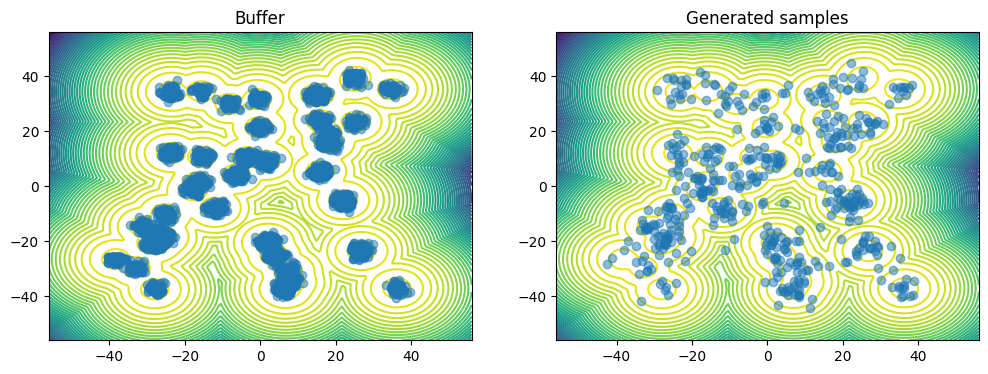

  3%|▎         | 311/10000 [19:18<10:40:19,  3.97s/it]

Epoch 0 | Loss 0.118977


  3%|▎         | 312/10000 [19:22<10:22:39,  3.86s/it]

Epoch 0 | Loss 0.104121


  3%|▎         | 313/10000 [19:26<10:10:38,  3.78s/it]

Epoch 0 | Loss 0.274555


  3%|▎         | 314/10000 [19:29<10:01:15,  3.72s/it]

Epoch 0 | Loss 0.122337


  3%|▎         | 315/10000 [19:33<9:57:50,  3.70s/it] 

Epoch 0 | Loss 0.128286


  3%|▎         | 316/10000 [19:37<9:53:07,  3.67s/it]

Epoch 0 | Loss 0.104460


  3%|▎         | 317/10000 [19:40<10:04:34,  3.75s/it]

Epoch 0 | Loss 0.084462


  3%|▎         | 318/10000 [19:44<9:57:38,  3.70s/it] 

Epoch 0 | Loss 0.096179


  3%|▎         | 319/10000 [19:48<9:50:09,  3.66s/it]

Epoch 0 | Loss 0.093062


  3%|▎         | 320/10000 [19:51<9:45:49,  3.63s/it]

Epoch 0 | Loss 0.105593


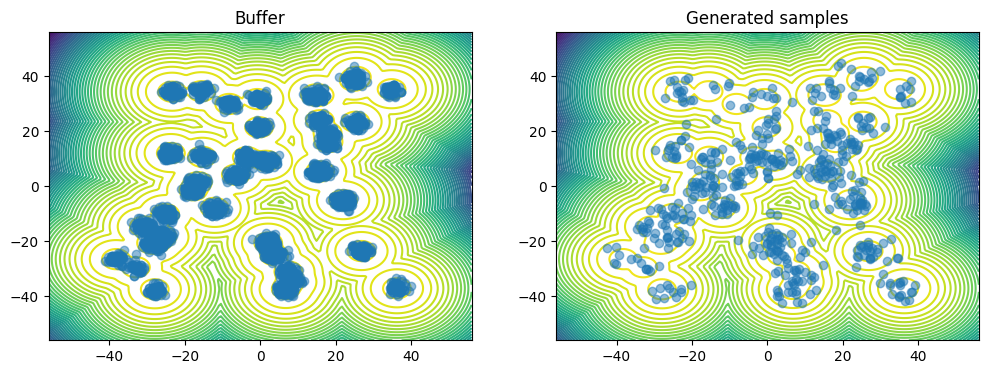

  3%|▎         | 321/10000 [19:56<10:27:19,  3.89s/it]

Epoch 0 | Loss 0.663754


  3%|▎         | 322/10000 [19:59<10:12:57,  3.80s/it]

Epoch 0 | Loss 0.102940


  3%|▎         | 323/10000 [20:03<10:02:57,  3.74s/it]

Epoch 0 | Loss 0.069517


  3%|▎         | 324/10000 [20:06<9:54:55,  3.69s/it] 

Epoch 0 | Loss 0.169573


  3%|▎         | 325/10000 [20:10<9:50:20,  3.66s/it]

Epoch 0 | Loss 0.098153


  3%|▎         | 326/10000 [20:14<9:52:27,  3.67s/it]

Epoch 0 | Loss 0.205659


  3%|▎         | 327/10000 [20:17<9:48:16,  3.65s/it]

Epoch 0 | Loss 2.154656


  3%|▎         | 328/10000 [20:21<10:00:39,  3.73s/it]

Epoch 0 | Loss 0.361034


  3%|▎         | 329/10000 [20:25<9:53:43,  3.68s/it] 

Epoch 0 | Loss 0.209004


  3%|▎         | 330/10000 [20:28<9:49:21,  3.66s/it]

Epoch 0 | Loss 0.075728


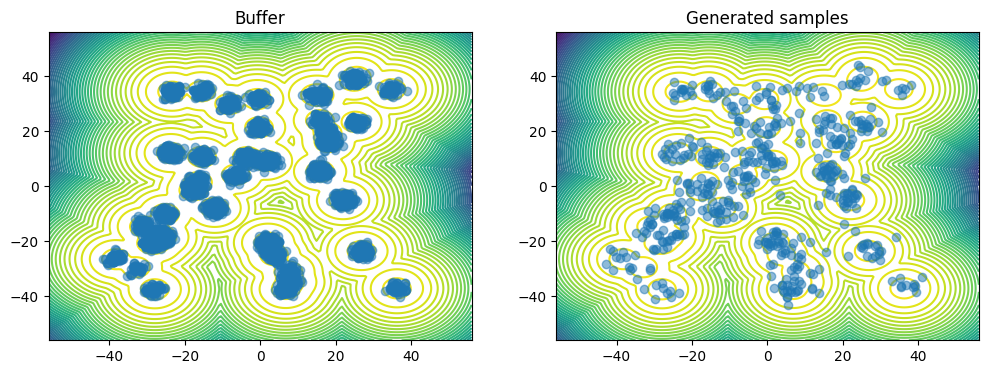

  3%|▎         | 331/10000 [20:33<10:29:26,  3.91s/it]

Epoch 0 | Loss 0.135135


  3%|▎         | 332/10000 [20:36<10:14:26,  3.81s/it]

Epoch 0 | Loss 0.081506


  3%|▎         | 333/10000 [20:40<10:02:22,  3.74s/it]

Epoch 0 | Loss 0.213472


  3%|▎         | 334/10000 [20:44<9:54:40,  3.69s/it] 

Epoch 0 | Loss 0.122517


  3%|▎         | 335/10000 [20:47<9:49:01,  3.66s/it]

Epoch 0 | Loss 0.173894


  3%|▎         | 336/10000 [20:51<9:45:03,  3.63s/it]

Epoch 0 | Loss 0.154541


  3%|▎         | 337/10000 [20:54<9:46:43,  3.64s/it]

Epoch 0 | Loss 0.094862


  3%|▎         | 338/10000 [20:58<9:43:15,  3.62s/it]

Epoch 0 | Loss 0.070146


  3%|▎         | 339/10000 [21:02<9:57:21,  3.71s/it]

Epoch 0 | Loss 0.208510


  3%|▎         | 340/10000 [21:05<9:50:46,  3.67s/it]

Epoch 0 | Loss 0.156245


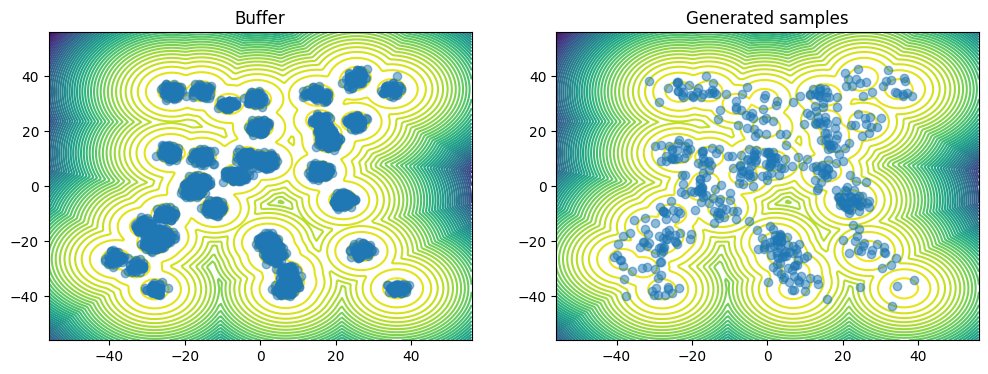

  3%|▎         | 341/10000 [21:10<10:29:14,  3.91s/it]

Epoch 0 | Loss 0.127030


  3%|▎         | 342/10000 [21:14<10:28:45,  3.91s/it]

Epoch 0 | Loss 0.100495


  3%|▎         | 343/10000 [21:17<10:12:18,  3.80s/it]

Epoch 0 | Loss 0.303913


  3%|▎         | 344/10000 [21:21<10:01:28,  3.74s/it]

Epoch 0 | Loss 0.101103


  3%|▎         | 345/10000 [21:25<9:53:41,  3.69s/it] 

Epoch 0 | Loss 0.075567


  3%|▎         | 346/10000 [21:28<9:47:22,  3.65s/it]

Epoch 0 | Loss 0.093070


  3%|▎         | 347/10000 [21:32<9:43:26,  3.63s/it]

Epoch 0 | Loss 0.217831


  3%|▎         | 348/10000 [21:35<9:47:42,  3.65s/it]

Epoch 0 | Loss 0.100582


  3%|▎         | 349/10000 [21:39<9:43:48,  3.63s/it]

Epoch 0 | Loss 0.464961


  4%|▎         | 350/10000 [21:43<9:41:00,  3.61s/it]

Epoch 0 | Loss 0.104193


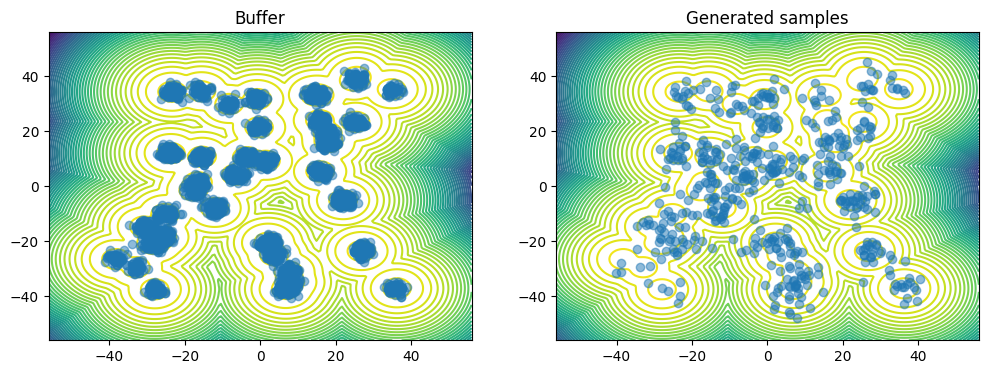

  4%|▎         | 351/10000 [21:47<10:40:54,  3.99s/it]

Epoch 0 | Loss 0.207898


  4%|▎         | 352/10000 [21:51<10:21:07,  3.86s/it]

Epoch 0 | Loss 0.054641


  4%|▎         | 353/10000 [21:55<10:07:09,  3.78s/it]

Epoch 0 | Loss 0.095401


  4%|▎         | 354/10000 [21:58<9:57:03,  3.71s/it] 

Epoch 0 | Loss 0.255873


  4%|▎         | 355/10000 [22:02<9:51:11,  3.68s/it]

Epoch 0 | Loss 0.177906


  4%|▎         | 356/10000 [22:05<9:46:00,  3.65s/it]

Epoch 0 | Loss 0.100321


  4%|▎         | 357/10000 [22:09<9:44:02,  3.63s/it]

Epoch 0 | Loss 0.079664


  4%|▎         | 358/10000 [22:13<9:42:23,  3.62s/it]

Epoch 0 | Loss 0.074921


  4%|▎         | 359/10000 [22:16<9:40:47,  3.61s/it]

Epoch 0 | Loss 0.086030


  4%|▎         | 360/10000 [22:20<9:38:34,  3.60s/it]

Epoch 0 | Loss 0.080464


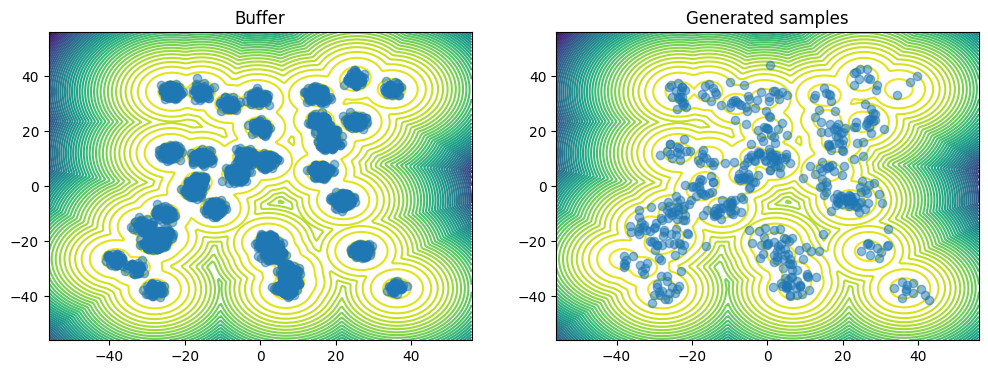

  4%|▎         | 361/10000 [22:24<10:36:47,  3.96s/it]

Epoch 0 | Loss 0.083410


  4%|▎         | 362/10000 [22:28<10:18:43,  3.85s/it]

Epoch 0 | Loss 0.114597


  4%|▎         | 363/10000 [22:32<10:05:41,  3.77s/it]

Epoch 0 | Loss 0.317506


  4%|▎         | 364/10000 [22:35<9:56:13,  3.71s/it] 

Epoch 0 | Loss 0.148125


  4%|▎         | 365/10000 [22:39<9:49:34,  3.67s/it]

Epoch 0 | Loss 0.156618


  4%|▎         | 366/10000 [22:42<9:46:05,  3.65s/it]

Epoch 0 | Loss 0.094210


  4%|▎         | 367/10000 [22:46<9:43:49,  3.64s/it]

Epoch 0 | Loss 0.112890


  4%|▎         | 368/10000 [22:50<9:40:38,  3.62s/it]

Epoch 0 | Loss 0.680866


  4%|▎         | 369/10000 [22:53<9:38:11,  3.60s/it]

Epoch 0 | Loss 0.063833


  4%|▎         | 370/10000 [22:57<9:37:17,  3.60s/it]

Epoch 0 | Loss 0.177362


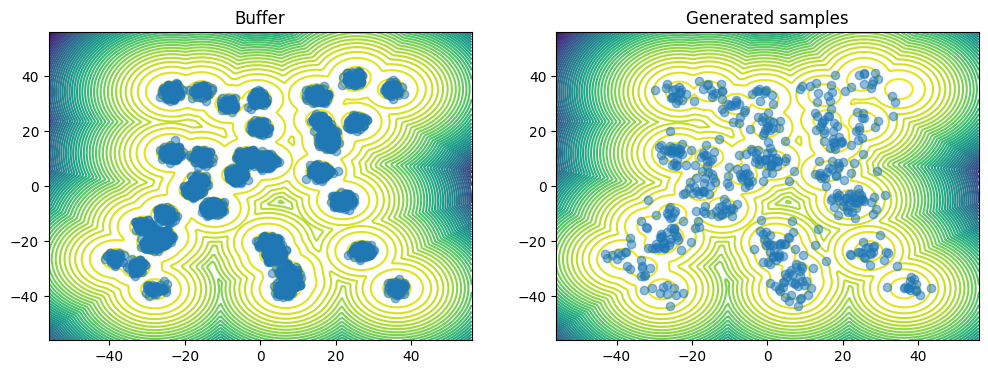

  4%|▎         | 371/10000 [23:02<10:38:26,  3.98s/it]

Epoch 0 | Loss 0.076795


  4%|▎         | 372/10000 [23:05<10:19:13,  3.86s/it]

Epoch 0 | Loss 0.154222


  4%|▎         | 373/10000 [23:09<10:05:16,  3.77s/it]

Epoch 0 | Loss 0.074702


  4%|▎         | 374/10000 [23:12<10:01:35,  3.75s/it]

Epoch 0 | Loss 0.085646


  4%|▍         | 375/10000 [23:16<10:01:44,  3.75s/it]

Epoch 0 | Loss 0.074316


  4%|▍         | 376/10000 [23:20<9:55:47,  3.71s/it] 

Epoch 0 | Loss 0.123858


  4%|▍         | 376/10000 [23:23<9:58:39,  3.73s/it]


KeyboardInterrupt: 

In [108]:
def score_wrapper(vectorfield):
    def score(x, t, noise_schedule):
        h_t = noise_schedule.h(t)
        #h_t = beta * t
        return vectorfield(x, t) / (h_t + 1e-3).unsqueeze(1)
    
    return score

all_losses = []
binned_losses = [[] for _ in range(10)]
for outer_epoch in tqdm(range(outer_epochs)):
    for epoch in range(inner_epochs):
        total_loss = 0.
        for samples,_ in init_loader:
            samples = samples.to(device)
            opt_vectorfield.zero_grad()
            #t = torch.rand(len(samples), device=device)

            # 80 % sample from (0, 0.1), 20% sample from (0.1, 1)
            # x0 is data
            low_time_t = (-0.1 * torch.rand(len(samples), device=device)) + 0.1
            high_time_t = (-0.9 * torch.rand(len(samples), device=device)) + 1.0
            mask = torch.rand(len(samples), device=device) < 0.9
            t = (low_time_t * mask) + (high_time_t * ~mask)

            #t = LogUniform(torch.tensor(0.001, device=device), torch.tensor(1.0, device=device)).sample((len(samples),))
            t = torch.rand(len(samples), device=device)

            losses = reward_matching_loss_biased(vectorfield, samples, t, noise_schedule) # score_loss(vectorfield, samples, t)
            #losses = score_loss(vectorfield, samples, t)
            loss = losses.mean()
            total_loss += loss.item()
            loss.backward()
            opt_vectorfield.step()
            
            all_losses.append(loss.detach().cpu().item())
            
            for i, loss_bin in enumerate(binned_losses):
                bin_start = i / 20.0
                bin_end = bin_start + 0.05
                
                t_idx = (bin_start <= t) & (t <= bin_end)
                bin_losses = losses[t_idx]
                
                if len(bin_losses) > 0:
                    loss_bin.append(bin_losses.mean().detach().cpu())
                
        if epoch % 49 == 0:
            print("Epoch %d | Loss %f" % (epoch, loss.item()))


    # Generate samples using the network
    ve_reverse_sde = VEReverseSDE(score_wrapper(vectorfield), noise_schedule)

    noise = torch.randn_like(x1_samples_normalized) * (beta ** 0.5)
    samples = integrate_sde(ve_reverse_sde, noise, [0, 0.999], 1e-3)[0][-1]
    samples_energy = target.log_prob(unnormalize(samples, global_mins, global_maxs)).detach()
    # Update Buffer 
    buffer.add(samples, samples_energy)

    if outer_epoch % 10 == 0:
        plot_dataset(unnormalize(train_dataset.tensors[0], global_mins, global_maxs), 
                     unnormalize(samples, global_mins, global_maxs))
        plt.show()
        
    # Resample data from the buffer
    samples, samples_energy, _ = buffer.sample(512 * 10)
    train_dataset = TensorDataset(samples, samples_energy)
    trainloader = DataLoader(train_dataset, batch_size = 512, shuffle=True)

Text(0.5, 0, 'epoch')

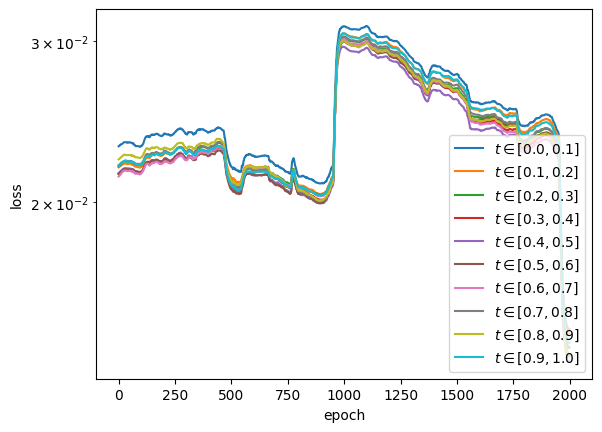

In [109]:
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w


for i, bin_loss in enumerate(binned_losses):
    plt.plot(moving_average(torch.tensor(bin_loss).cpu().numpy(), 1000)[-2000:], label=r'$t \in [%.1f, %.1f]$' % (i / 10.0, ((i + 1) / 10.0)))
plt.yscale('log')
plt.legend()
plt.ylabel('loss')
plt.xlabel('epoch')

In [110]:
vf_beta = copy.deepcopy(vectorfield.state_dict())

NameError: name 'copy' is not defined

In [111]:
import copy

vf_sqrt_beta = copy.deepcopy(vectorfield.state_dict())

In [238]:
vectorfield.load_state_dict(vf_beta)

<All keys matched successfully>

In [56]:
x1_samples_normalized.repeat(5,1).shape

torch.Size([2560, 2])

### Evaluation

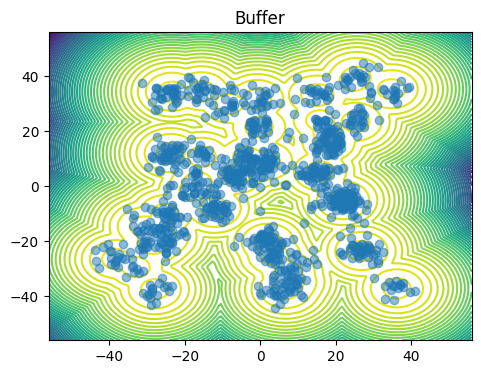

[<Figure size 1200x400 with 1 Axes>]

In [112]:
noise = (torch.randn_like(x1_samples_normalized.repeat(2,1)) * (beta ** 0.5))
samples = integrate_sde(ve_reverse_sde, noise, [0, 0.999], 1e-3)[0][-1]

plot_dataset(unnormalize(samples, global_mins, global_maxs))

In [283]:
beta = 0.2

In [113]:
from torch.func import jacrev

In [184]:
follow_estimate = True
follow_true = False
follow_model = False

In [426]:
def drift(x, t):
    with torch.enable_grad():
        x.requires_grad = True
        #if (t > 0.7).any():
        #    import pdb; pdb.set_trace()
        g_t = noise_schedule.g(t) ** 2
        if follow_estimate:
            f = -0.5 * g_t.unsqueeze(-1) * estimate_grad_Rt(x, t, noise_schedule, num_mc_samples=100)
            norm = torch.linalg.vector_norm(f, dim=-1)
            #print(norm.max())
            max_norm = 5
            clip_coef = torch.clamp(max_norm / (norm+1e-6), max=1)
            f = f * clip_coef.unsqueeze(-1)
        elif follow_true:
            f = - 0.5 * g_t.unsqueeze(-1) * true_grad_Rt(x, t, noise_schedule)
        elif follow_model:
            h_t = noise_schedule.h(t)
            f = - 0.5 * g_t.unsqueeze(-1) * vectorfield(x, t) / (h_t + 1e-3).unsqueeze(1)
            #return f
            norm = torch.linalg.vector_norm(f, dim=-1)
            # print("norm", norm.max())
            max_norm = 10
            clip_coef = torch.clamp(max_norm / (norm+1e-6), max=1)
            f = f  * clip_coef.unsqueeze(-1)
            # print("clipped norm", torch.linalg.vector_norm(f, dim=-1).max())
    return f

In [392]:
def div_fn(u):
    """Accepts a function u:R^D -> R^D."""
    J = jacrev(u)
    def div(x):
        return torch.trace(J(x.unsqueeze(0)).squeeze())
    return div

def output_and_div(vecfield, x):
    if follow_estimate:
        dx = vecfield(x)
        #dx = torch.vmap(vecfield, randomness="different")(x)
        div = torch.vmap(div_fn(vecfield), randomness="different")(x)
    elif follow_true:
        dx = vecfield(x)
        div = torch.vmap(div_fn(vecfield), randomness="different")(x.clone().detach().requires_grad_(True))
    elif follow_model:
        dx = vecfield(x)
        div = torch.vmap(div_fn(vecfield), randomness="different")(x)
    return dx, div

In [393]:
def prior_dist(beta):
    dist = torch.distributions.MultivariateNormal(
        torch.zeros(2).to(device), torch.eye(2).to(device) * beta
    )
    return dist

In [394]:
reverse_time = False

In [293]:
unnorm_test_samples = target.sample((init_num_samples,)).to(device).detach()

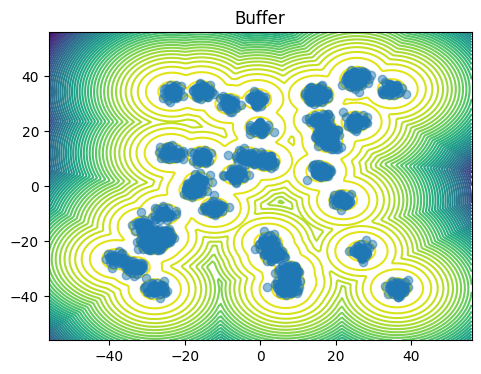

[<Figure size 1200x400 with 1 Axes>]

In [294]:
plot_dataset(unnorm_test_samples)

In [400]:
def odefunc(t, x_in):
    x = x_in[..., :-1].clone().detach().requires_grad_(True)
    t = t.to(device)
    vecfield = lambda x: drift(x, t)
    if True:#follow_model or follow_estimate:
        def vecfield(x):
            return drift(x, torch.ones(x.shape[0]).to(device) * t)
    dx, div = output_and_div(vecfield, x)
    div = div.reshape(-1, 1)
    return torch.cat([dx, div], dim=-1)

In [428]:
follow_model = True
follow_estimate = False
follow_true = False
with torch.no_grad():
    if reverse_time:
        x1 = torch.randn(1024, 2).to(device) * np.sqrt(beta)
        time = torch.linspace(1, 0, 1000).to(device)
    else:
        x1, _, _ = normalize(unnorm_test_samples)
        time = torch.linspace(0, 1, 1000).to(device)
    state1 = torch.cat([x1, torch.zeros_like(x1[..., :1])], dim=-1)
    state1.requires_grad = True
    states_traj = odeint(odefunc, state1, t=time, method="euler")
    state0 = states_traj[-1]

    x0, logdetjac = state0[..., :-1], state0[..., -1]
    p0 = prior_dist(500)#((noise_schedule.h(1) * (50 ** 2)) ** 0.5) * 50 * 50)
    logp0 = p0.log_prob(unnormalize(x0, global_mins, global_maxs))
    logp1 = -(logp0 + logdetjac)

In [429]:
((beta * 50 * 50) ** 0.5) * 50 * 50

999.9999999500002

In [430]:
print("logp0", logp0.mean())
print("logdetjac", logdetjac.mean())
print("logp1", logp1.mean())

logp0 tensor(-9.4385, device='cuda:0')
logdetjac tensor(2.0781, device='cuda:0')
logp1 tensor(7.3604, device='cuda:0')


In [258]:
log_p0_true = true_Rt(prior_samples, torch.tensor(1).to(device), beta)
print("logp0 true: ", log_p0_true.mean())

AttributeError: 'float' object has no attribute 'h'

In [530]:
log_p0_true = true_Rt(x0, torch.tensor(1).to(device), beta)
print("logp0 true: ", log_p0_true.mean())

logp0 true:  tensor(-9.7362, device='cuda:0')


In [531]:
-(log_p0_true + logdetjac).mean()

tensor(7.3265, device='cuda:0')

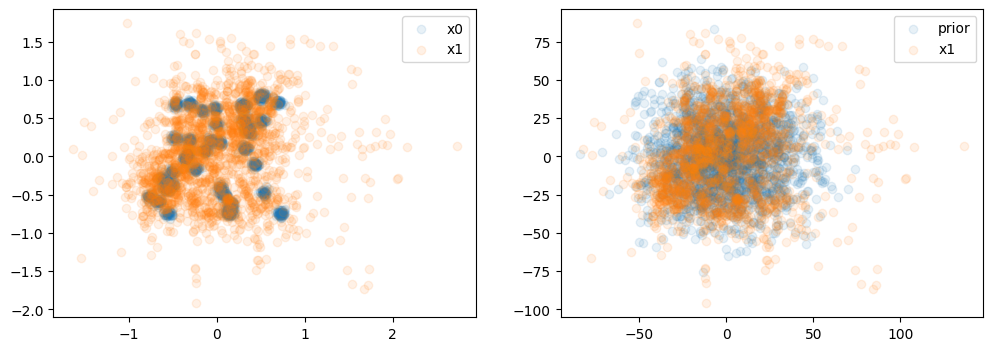

In [427]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4))
ax[0].scatter(x1[:, 0].detach().cpu(), x1[:, 1].detach().cpu(), alpha=0.1, label="x0")
ax[0].scatter(x0[:, 0].detach().cpu(), x0[:, 1].detach().cpu(), alpha=0.1, label="x1")


prior_samples = p0.sample((2048,))
if reverse_time:
    ax[0].scatter(prior_samples[:, 0].detach().cpu(), prior_samples[:, 1].detach().cpu(), alpha=0.2, label="prior")
    ax[1].scatter(samples[:, 0].detach().cpu(), samples[:, 1].detach().cpu(), alpha=0.1, label="generated samples")
else:
    ax[1].scatter(prior_samples[:, 0].detach().cpu(), prior_samples[:, 1].detach().cpu(), alpha=0.1, label="prior")
ax[0].legend()

x0_unnormalized = unnormalize(x0, global_mins, global_maxs)
ax[1].scatter(x0_unnormalized[:, 0].detach().cpu(), x0_unnormalized[:, 1].detach().cpu(), alpha=0.1, label="x1")
ax[1].legend()
#ax[0].set_xlim(-2,2)
#ax[0].set_ylim(-2,2)
#plt.xlim(-2, 2)
#plt.ylim(-2, 2)
plt.show()

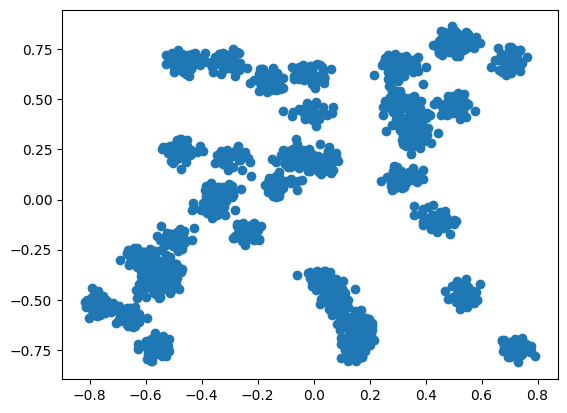

In [138]:
plt.scatter(*states_traj[-1, :, :2].T.cpu())

In [134]:
states_traj[1].shape

torch.Size([2048, 3])

In [88]:
x0.abs().mean(1).argmax()

tensor(702, device='cuda:0')

In [89]:
x0[702]

tensor([-17.8094,  52.6267], device='cuda:0')

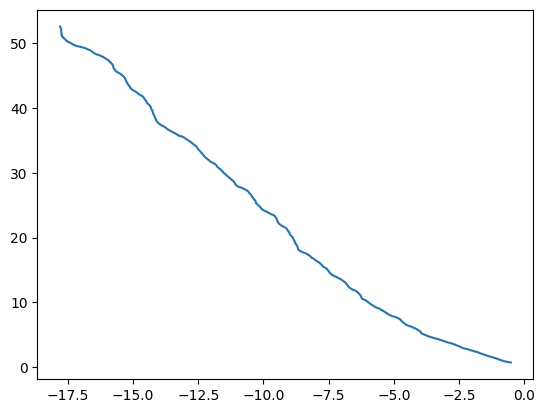

In [94]:
plt.plot(states_traj[:, 702, 0].cpu(), states_traj[:, 702, 1].cpu())

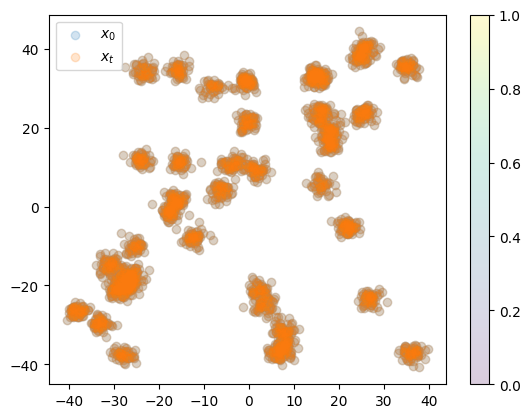

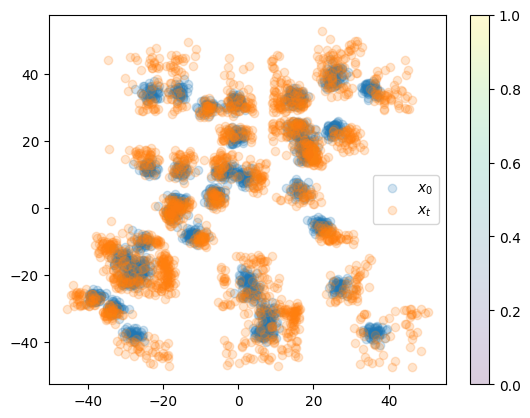

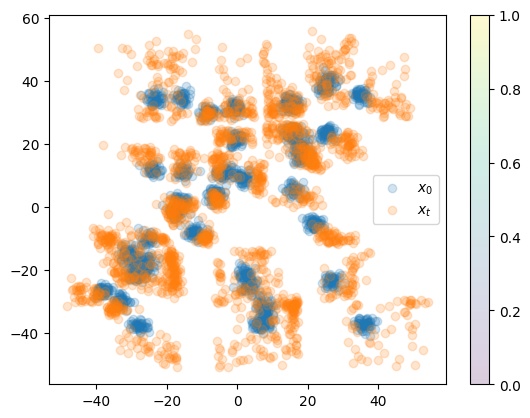

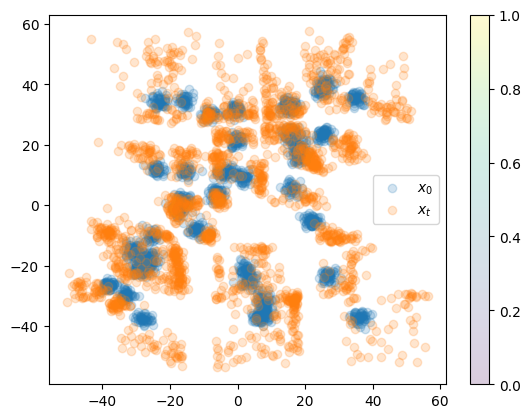

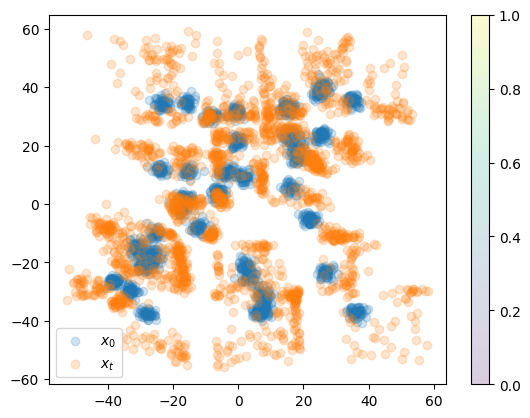

...

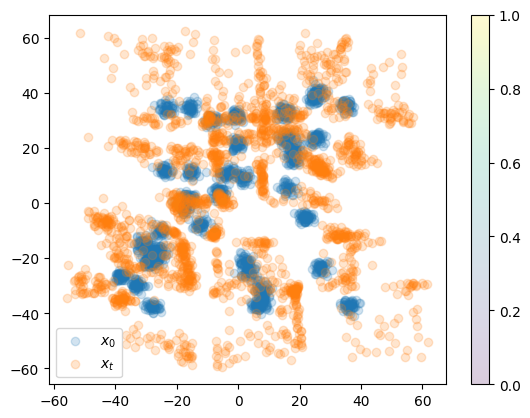

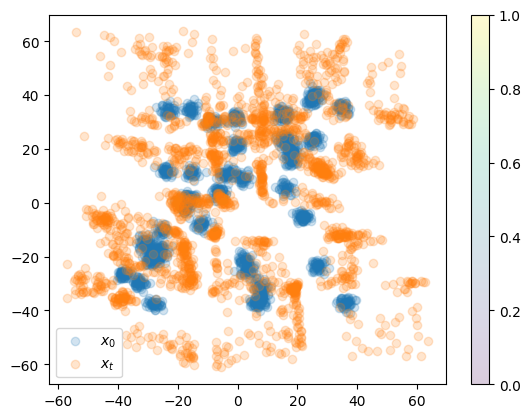

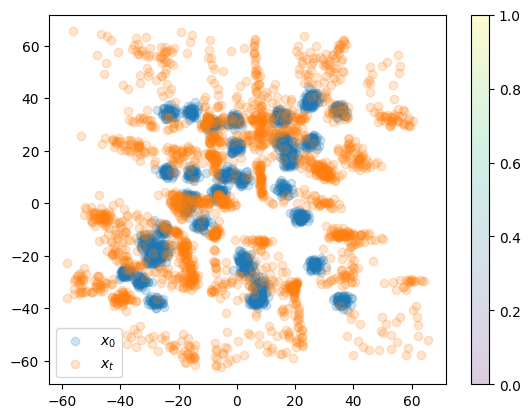

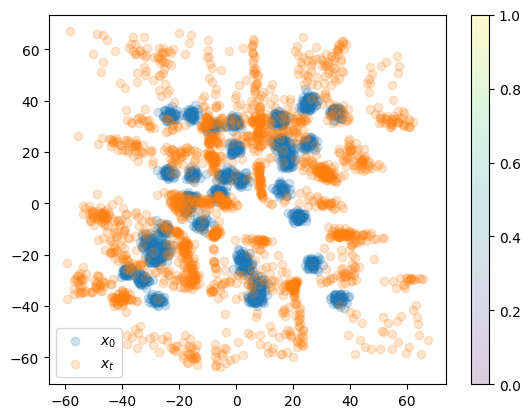

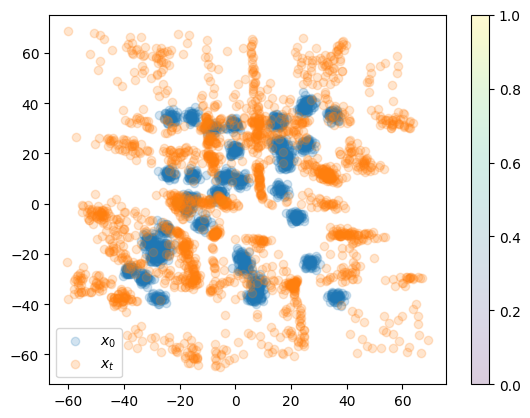

In [503]:
plot_traj = unnormalize(states_traj, global_mins, global_maxs)


for i in range(0, plot_traj.shape[0], 99):
    t = i / float(len(plot_traj))
        
    plt.scatter(plot_traj[0, :, 0].cpu(), plot_traj[0,:,1].cpu(), alpha=0.2, label=r'$x_0$')
    plt.scatter(plot_traj[i, :, 0].cpu(), plot_traj[i,:,1].cpu(), alpha=0.2, label=r'$x_t$')
        
    x_min, x_max = plt.xlim()
    y_min, y_max = plt.ylim()
    
    X = torch.linspace(x_min, x_max, num_grid)
    Y = torch.linspace(y_min, y_max, num_grid)

    # create a grid of (x,y) coordinates
    x = torch.meshgrid(X, Y)

    # make x into tensor
    x = torch.stack(x, dim=2).reshape(-1, 2)
    x = x.to(device)
    #x.requires_grad = True
    
    x = normalize(x)[0]
    vf = drift(x, torch.full((len(x),), fill_value=t, device=device))
    #plt.imshow(vf.reshape(num_grid, num_grid, 2)[..., 1].detach().cpu(), extent=[x_min, x_max, y_min, y_max])

    plt.colorbar()
    plt.legend()

    #plt.ylim(-100, 100)
    plt.show()

In [ ]:
norms = []
learned_norms = []
estimated_norms = []
raw_pred_norms = []
for t in tqdm(torch.linspace(0.0, 1.0, 100)):
    num_grid = 100
    X = torch.linspace(-1, 1, num_grid)
    Y = torch.linspace(-1, 1, num_grid)

    # create a grid of (x,y) coordinates
    x = torch.meshgrid(X, Y)

    # make x into tensor
    x = torch.stack(x, dim=2).reshape(-1, 2)
    x = x.to(device)
    x.requires_grad = True

    t = t.unsqueeze(0)

    h_t = noise_schedule.h(t)

    true = true_grad_Rt(x, t, noise_schedule, var_exploding=True).detach()
    stochastic_estimate = torch.cat([
        estimate_grad_Rt(x.to(device), t.repeat(len(x)).to(device), noise_schedule, num_mc_samples=100).detach().unsqueeze(0)
        for _ in range(10)
    ]).mean(0)
    unaltered_predicted = vectorfield(x.to(device), t.repeat(len(x)).to(device)).cpu().detach()
    predicted = unaltered_predicted / (1e-3 + h_t)

    norms.append(torch.linalg.norm(true, dim=-1).mean())
    learned_norms.append(torch.linalg.norm(predicted, dim=-1).mean())
    raw_pred_norms.append(torch.linalg.norm(unaltered_predicted, dim=-1).mean())
    estimated_norms.append(torch.linalg.norm(stochastic_estimate, dim=-1).mean())

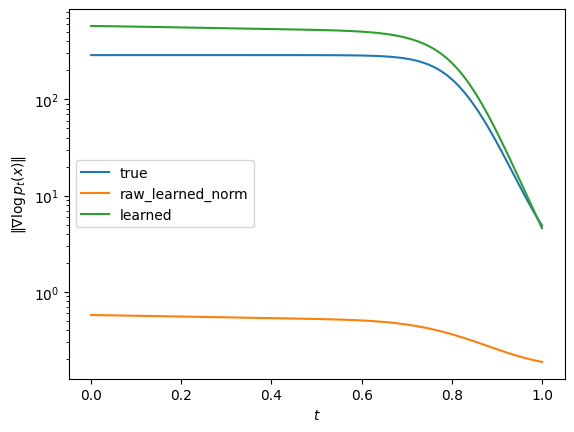

In [197]:
plt.plot(torch.linspace(0.0, 1.0, 100), torch.tensor(norms), label='true')
plt.plot(torch.linspace(0.0, 1.0, 100), torch.tensor(raw_pred_norms), label='raw_learned_norm')
plt.plot(torch.linspace(0.0, 1.0, 100), torch.tensor(learned_norms), label='learned')
plt.legend()
plt.xlabel(r'$t$')
plt.ylabel(r'$\|\nabla \log p_t(x)\|$')
plt.yscale('log')

In [208]:
torch.tensor(raw_pred_norms)[0]

tensor(0.1880)

ValueError: x and y must have same first dimension, but have shapes torch.Size([100]) and torch.Size([0])

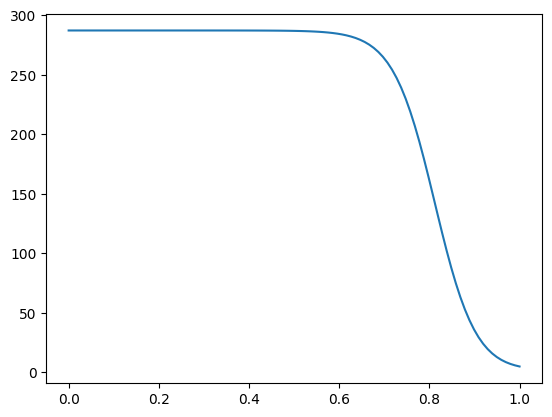

In [194]:
plt.plot(torch.linspace(0.0, 1.0, 100), torch.tensor(norms), label='true')
plt.plot(torch.linspace(0.0, 1.0, 100), torch.tensor(estimated_norms), label='estimated')
plt.plot(torch.linspace(0.0, 1.0, 100), torch.tensor(learned_norms), label='learned')
plt.legend()
plt.xlabel(r'$t$')
plt.ylabel(r'$\|\nabla \log p_t(x)\|$')
plt.yscale('log')

In [408]:
torch.tensor(norms)

tensor([287.0571, 278.8618, 271.1163,  ...,   1.7711,   1.7710,   1.7710])

In [179]:
num_grid = 100
X = torch.linspace(-1, 1, num_grid)
Y = torch.linspace(-1, 1, num_grid)

# create a grid of (x,y) coordinates
x = torch.meshgrid(X, Y)

# make x into tensor
x = torch.stack(x, dim=2).reshape(-1, 2)
x = x.to(device)
x.requires_grad = True

t = torch.rand(1, device=device)
t = t * 0 + 0.01

num_mc_samples = 100

In [180]:
beta * t

tensor([0.0020], device='cuda:0')

In [181]:
h_t = noise_schedule.h(t)

true = true_grad_Rt(x, t, noise_schedule, var_exploding=True).detach()
predicted = (vectorfield(x, t.repeat(len(x))) / (1e-3 + h_t).unsqueeze(1)).cpu().detach()
stochastic_estimate = torch.cat([
    estimate_grad_Rt(x, t.repeat(len(x)), noise_schedule, num_mc_samples=100).detach().unsqueeze(0)
    for _ in tqdm(range(10))
]).mean(0)

100%|██████████| 10/10 [00:00<00:00, 23.94it/s]


In [182]:
print(predicted * (5e-3 + h_t.cpu()))
print(predicted)

tensor([[ 4.6234,  5.1902],
        [ 4.7529,  4.9664],
        [ 4.9414,  4.6364],
        ...,
        [-5.1281, -2.8096],
        [-5.2648, -3.0411],
        [-5.3885, -3.2749]])
tensor([[  924.6860,  1038.0491],
        [  950.5867,   993.2897],
        [  988.2816,   927.2836],
        ...,
        [-1025.6222,  -561.9300],
        [-1052.9696,  -608.2216],
        [-1077.6980,  -654.9872]])


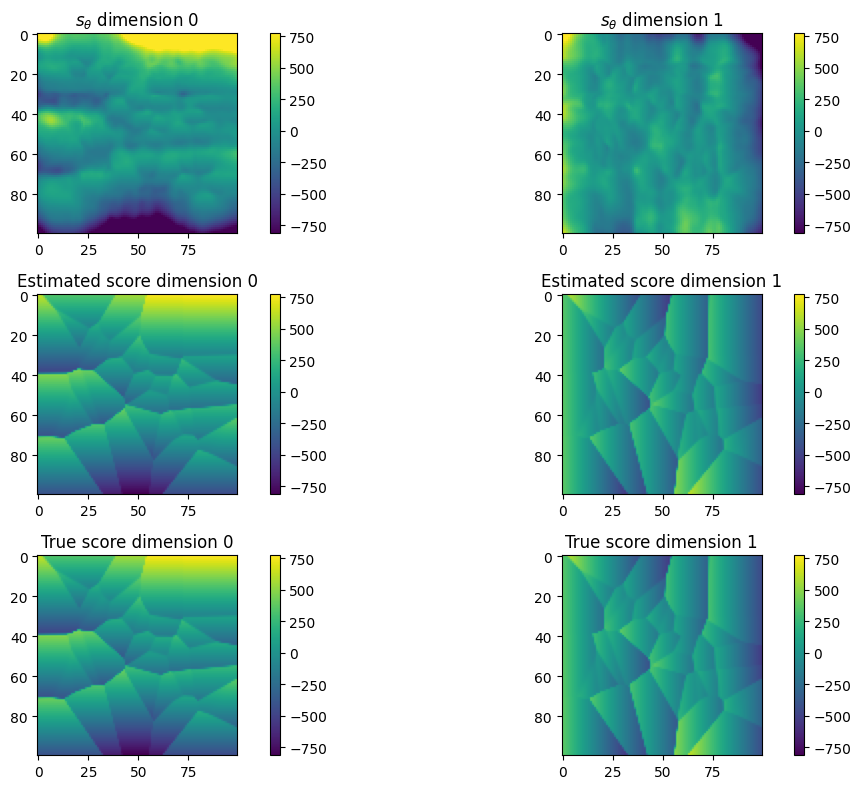

In [183]:
fig, axs = plt.subplots(3, 2, figsize=(12, 8))

vmin = true.min()
vmax = true.max()

im = axs[0,0].imshow(predicted.reshape(num_grid, num_grid, 2)[..., 0].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[0,0])
axs[0,0].set_title(r'$s_\theta$ dimension 0')

im = axs[0,1].imshow(predicted.reshape(num_grid, num_grid, 2)[..., 1].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[0,1])
axs[0,1].set_title(r'$s_\theta$ dimension 1')
#del grad_Rt
#del grads_Rt

im = axs[1,0].imshow(stochastic_estimate.reshape(num_grid, num_grid, 2)[..., 0].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[1,0])
axs[1,0].set_title(r'Estimated score dimension 0')

im = axs[1,1].imshow(stochastic_estimate.reshape(num_grid, num_grid, 2)[..., 1].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[1,1])
axs[1,1].set_title(r'Estimated score dimension 1')

im = axs[2,0].imshow(true.reshape(num_grid, num_grid, 2)[..., 0].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[2,0])
axs[2,0].set_title(r'True score dimension 0')

im = axs[2,1].imshow(true.reshape(num_grid, num_grid, 2)[..., 1].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[2,1])
axs[2,1].set_title(r'True score dimension 1')
#del grad_Rt
#del grads_Rt

plt.tight_layout()
plt.show()

In [163]:
import gc
torch.cuda.empty_cache()
gc.collect()

27384

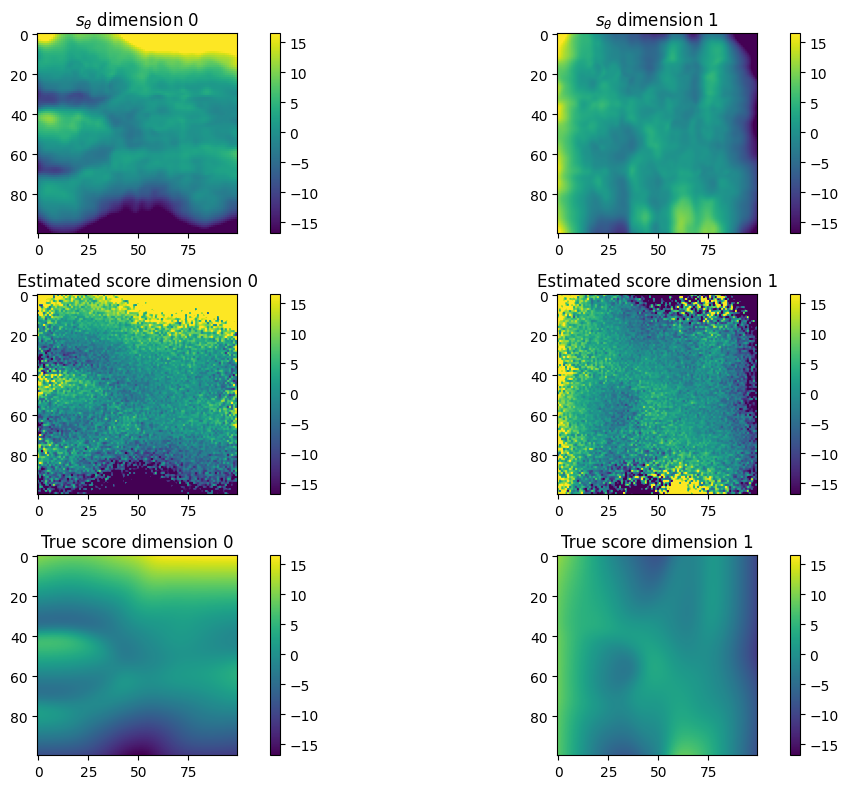

In [164]:
fig, axs = plt.subplots(3, 2, figsize=(12, 8))

vmin = true.min()
vmax = true.max()

im = axs[0,0].imshow(predicted.reshape(num_grid, num_grid, 2)[..., 0].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[0,0])
axs[0,0].set_title(r'$s_\theta$ dimension 0')

im = axs[0,1].imshow(predicted.reshape(num_grid, num_grid, 2)[..., 1].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[0,1])
axs[0,1].set_title(r'$s_\theta$ dimension 1')
#del grad_Rt
#del grads_Rt

im = axs[1,0].imshow(stochastic_estimate.reshape(num_grid, num_grid, 2)[..., 0].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[1,0])
axs[1,0].set_title(r'Estimated score dimension 0')

im = axs[1,1].imshow(stochastic_estimate.reshape(num_grid, num_grid, 2)[..., 1].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[1,1])
axs[1,1].set_title(r'Estimated score dimension 1')

im = axs[2,0].imshow(true.reshape(num_grid, num_grid, 2)[..., 0].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[2,0])
axs[2,0].set_title(r'True score dimension 0')

im = axs[2,1].imshow(true.reshape(num_grid, num_grid, 2)[..., 1].cpu(), vmin=vmin, vmax=vmax)
# colorbar for subplot
plt.colorbar(im, ax=axs[2,1])
axs[2,1].set_title(r'True score dimension 1')
#del grad_Rt
#del grads_Rt

plt.tight_layout()
plt.show()

In [71]:
samples = torch.randn((1000, 2)) * (20)

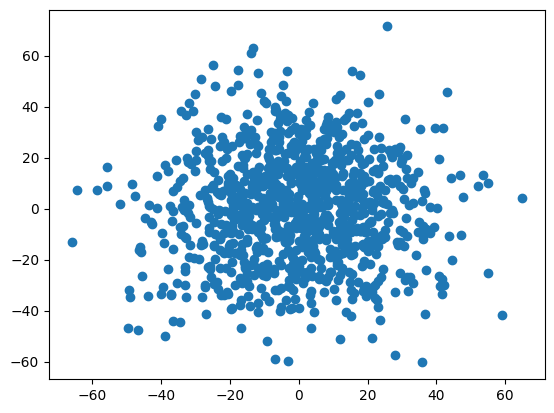

In [72]:
plt.scatter(*samples.T)

In [73]:
20**2

400